<img src="https://upload.wikimedia.org/wikipedia/fr/thumb/5/50/Sante-publique-France-logo.svg/1200px-Sante-publique-France-logo.svg.png" style="float:right;background-color:#FFFFFF;padding:1%;width:15%" />

# OpenFoodFacts / Santé publique France
Objectif : améliorer la santé des concitoyens 
- informer les citoyens sur les produits les plus gras,salés, sucrés
- trouver les produits les plus sains

## Questions
1. Quelles sont les catégories de produits ?
2. Quels sont les produits les plus sucrés ? salés ? gras ? protéinés ?
3. Quels sont les produits à la fois gras et salés ?
4. Quels sont les produits les plus mauvais pour la santé ?
5. Quels sont les produits riches en vitamines ?
6. Quels sont les produits bon pour la santé au petit déjeuner ?
7. Quelles sont les boissons saines ?
8. Quels produits pour se faire plaisir avec du chocolat sain ?
9. Y'a t-il de bons plats préparés ?
10. Quelle est l'offre en pâtes Bio bon pour la santé ?
11. Quels sont les laits Bio bon pour la santé ?
    <img src="https://static.openfoodfacts.org/images/misc/openfoodfacts-logo-fr-178x150.png" style="float:right;background-color:#FFFFFF;padding:1%;width:15%;" />





In [1]:
from __future__ import print_function
%matplotlib inline


import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.font_manager import FontProperties
import matplotlib as matplotlib
import matplotlib.colors as colors
import matplotlib.cm as cm
import seaborn as sns

#Fonctions utilitaires pour l'ACP
from functions import *


#Pour le téléchargement et l'affichage d'images
from PIL import Image
import requests
from io import BytesIO

import statsmodels.api as sm

#Pour une présentation interactive avec voila
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
from IPython.display import display, HTML
import plotly.express as px

#Calcul de correlation et significativité
from scipy import stats

<img src="https://pandas.pydata.org/pandas-docs/stable/_static/pandas.svg" style="float:right;background-color:#FFFFFF;padding:1%;width:10%;" />

## Setup pandas
Un peu de configuration pour l'affichage avec pandas

In [2]:
pd.set_option('display.max_rows', 50)
pd.set_option('display.max_columns', 30)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', 80)

<img src="https://matplotlib.org/_static/logo2_compressed.svg" style="float:right;background-color:#FFFFFF;padding:1%;width:10%;" />

## Setup Matplotlib
Quelques parametrages pour matplotlib

In [3]:
#setup
titleFontSize = 20
mentionFontSize = 10
#define font propertiers
font = FontProperties()
font.set_family('sans-serif')  
font.set_weight('light')
font.set_style('normal')
font.set_variant('normal')
#background color
plt.style.use('fivethirtyeight')
#fivethirtyeight 
#dark_background
plt.rcParams.update({'font.size' : 11})
COLOR = 'black'
plt.rcParams['text.color'] = COLOR
plt.rcParams['axes.labelcolor'] = COLOR
plt.rcParams['xtick.color'] = COLOR
plt.rcParams['ytick.color'] = COLOR

def draw_title(title,titleFontSize=titleFontSize,font = font):
    font.set_size(titleFontSize)
    plt.title(title,fontproperties=font)
    
def draw_mentions(text='source : openfoodfacts.org'):
    font.set_size(mentionFontSize)
    plt.figtext(0.50, 0.01, text, horizontalalignment='center',fontproperties=font)
    
def setup_figure(width=28,height=18):
    fig, ax = plt.subplots(figsize=(width/2.54,height/2.54))
    fig.patch.set_facecolor('white')
    
    return fig, ax

def display_products(df,field='image_small_url',title_fields=['product_name'],rows=2,columns=3):
    fig, ax = setup_figure(38,38)

    j=1
    for index,row in df.iterrows():
        img = row[field]
        # create a file-like object from the url
        a = plt.subplot(rows,columns,j)
        plt.axis("off")
        
        try:
            response = requests.get(img)
            i = Image.open(BytesIO(response.content))
            plt.imshow(i)
        except:
            print("Erreur lors de la lecture de cette url :",img)
            

        title = str(row['product_name'])[:35]
        a.set_title(title)
        j+=1
        
    plt.show()
    base_list = ['code','product_name','categories_fr','nutrition_grade_fr',
                 'additives_fr','energy_100g','sugars_100g','fat_100g','salt_100g','fruits-vegetables-nuts_100g']
    cols = base_list+list(set(title_fields)-set(base_list))
    display(df[cols])

In [4]:
#Définition de la palette de couleurs pour le nutri score
score_palette = ["#88CC00", "#AACC00","#FFCC00","#FF8800","#FF0000" ]

In [5]:
VALID_SCORES = ['a','b','c','d','e']

<img src="https://encrypted-tbn0.gstatic.com/images?q=tbn%3AANd9GcRtnybdPHhrTGcKHSDozZi9rXXSgZAdx3JauFla06ZTnegURu4m&usqp=CAU" style="float:right;background-color:#FFFFFF;padding:1%;width:10%;" />

## Lecture du fichier
Commençons par lire notre fichier CSV :
- Séparateur : tabulation
- Spécification des colonnes de type date


In [6]:
df = pd.read_csv("data/fr.openfoodfacts.org.products.csv",
                 sep = "\t",
                 skip_blank_lines = True,
                 parse_dates = ['created_datetime','last_modified_datetime'],
                 infer_datetime_format = True,
                )

/home/smougel/.conda/envs/eda_open_food_facts/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3165: DtypeWarning: Columns (0,3,5,19,20,24,25,26,27,28,35,36,37,38,39,48) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [7]:
print(df.shape)

(320772, 162)


320k lignes et 162 colonnes

In [8]:
#df.info(memory_usage='deep')
df.describe(include='all')

,code,url,creator,created_t,created_datetime,last_modified_t,last_modified_datetime,product_name,generic_name,quantity,packaging,packaging_tags,brands,brands_tags,categories,...,chromium_100g,molybdenum_100g,iodine_100g,caffeine_100g,taurine_100g,ph_100g,fruits-vegetables-nuts_100g,collagen-meat-protein-ratio_100g,cocoa_100g,chlorophyl_100g,carbon-footprint_100g,nutrition-score-fr_100g,nutrition-score-uk_100g,glycemic-index_100g,water-hardness_100g
count,3.207490e+05,320749,320770,3.207690e+05,320763,3.207720e+05,320772,303010,52795,104819,78960,78961,292360,292352,84410,...,20.000000,11.000000,259.000000,78.000000,29.000000,49.000000,3036.000000,165.000000,948.000000,0.0,268.000000,221210.000000,221210.000000,0.0,0.0
unique,3.206380e+05,320749,3535,1.896360e+05,189568,1.806390e+05,180495,221347,38584,13826,14547,12064,58784,50253,36982,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,8.760450e+11,http://world-fr.openfoodfacts.org/produit/0011246580874/strawberry-glaze-rob...,usda-ndb-import,1.489077e+09,2017-03-09T10:37:09Z,1.439142e+09,2015-08-09T17:35:42Z,Ice Cream,Pâtes alimentaires au blé dur de qualité supérieure,500 g,Carton,"sachet,plastique",Carrefour,carrefour,"Snacks sucrés,Biscuits et gâteaux,Biscuits",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,2.000000e+00,1,169868,2.000000e+01,20,3.300000e+01,33,410,201,4669,2153,3959,2978,3149,301,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.001690,0.000401,0.000427,1.594563,0.145762,6.425698,31.458587,15.412121,49.547785,NaN,341.700764,9.165535,9.058049,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.006697,0.001118,0.001285,6.475588,0.172312,2.047841,31.967918,3.753028,18.757932,NaN,425.211439,9.055903,9.183589,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.000007,0.000005,0.000000,0.000000,0.001800,0.000000,0.000000,8.000000,6.000000,NaN,0.000000,-15.000000,-15.000000,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.000011,0.000020,0.000015,0.015500,0.035000,6.300000,0.000000,12.000000,32.000000,NaN,98.750000,1.000000,1.000000,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.000024,0.000039,0.000034,0.021000,0.039000,7.200000,23.000000,15.000000,50.000000,NaN,195.750000,10.000000,9.000000,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.000068,0.000075,0.000103,0.043000,0.400000,7.400000,51.000000,15.000000,64.250000,NaN,383.200000,16.000000,16.000000,NaN,NaN


# Traitement du jeu de données

## Suppression des données inutiles

On enlève la redondance date time et timestamp.

La grande image n'est pas très utile dans notre cas pour prévisualiser les images.

On supprime la plus grande.

On supprime les portions qui contiennent des valeurs très hétérogênes

Le score anglais ne nous est pas utile

In [9]:
for c in df.columns:
    if "_t" in c:
        df.drop([c],axis=1,inplace=True)
    if c in ["nutrition_grade_uk","image_url","serving_size"]:
        df.drop([c],axis=1,inplace=True)

### Produits vendus en france

In [10]:
mask = (df.countries.str.contains('France', regex=False, case=False)==False)
df = df.drop(df[mask].index)

#print(df.countries.unique())
print(df.shape[0]," produits restants pour les produits vendus en France")

81145  produits restants pour les produits vendus en France


## Retrait des doublons sur le code

Analysons si nous avons des doublons sur les codes produits

In [11]:
df['code'].unique().size

81143

Inspectons ces lignes

In [12]:
dup_rows = df[df.duplicated('code', keep=False)].filter(
    ['code','creator','created_datetime','product_name','brands','categories'], axis=1)
dup_rows.sort_values(by=['code','created_datetime']).head(50)

,code,creator,created_datetime,product_name,brands,categories
9892,11778,beniben,2016-09-21T20:19:09Z,All Butter Reduced Fat Stem Ginger Cookies,Marks & Spencer,"Snacks sucrés,Biscuits et gâteaux,Biscuits,Cookies,Cookies au gingembre"
458,11778,gildubs,2017-03-31T15:58:35Z,Stem Ginger Cookies,Marks & Spencer,Cookies
67371,635646,date-limite-app,2015-02-14T12:19:51Z,M&S Vegetable pizza,Marks & Spencer,Vegetable pizzas
120240,635646,beniben,2016-09-22T05:15:44Z,Chargrilled Vegetable & Basil Pesto,Marks & Spencer,"Plats préparés,Pizzas tartes salées et quiches,Pizzas,Pizzas aux légumes gri..."


Peu de doublons sur les produits français (seulement 4)
Sur ces doublons, 1 produit en double et une erreur.

In [13]:
def duplicates_removal(df):
    cleaned = df.drop_duplicates('code', keep=False)
    
    return cleaned


In [14]:
df = duplicates_removal(df)
#On vérifie le résultat
print (df.shape[0]," Lignes après traitement des codes en double")

81141  Lignes après traitement des codes en double


## Retrait des colonnes vides
Certaines colonnes sont vides... Sans valeurs... Ou toutes égales à 0...

In [15]:
for c in df.columns:
    if df[c].count()==0:
        print ('Serie : ',c,' has no values')
        df = df.drop(c,axis=1)

Serie :  cities  has no values
Serie :  allergens_fr  has no values
Serie :  no_nutriments  has no values
Serie :  ingredients_from_palm_oil  has no values
Serie :  butyric-acid_100g  has no values
Serie :  caproic-acid_100g  has no values
Serie :  caprylic-acid_100g  has no values
Serie :  capric-acid_100g  has no values
Serie :  myristic-acid_100g  has no values
Serie :  palmitic-acid_100g  has no values
Serie :  stearic-acid_100g  has no values
Serie :  behenic-acid_100g  has no values
Serie :  lignoceric-acid_100g  has no values
Serie :  cerotic-acid_100g  has no values
Serie :  melissic-acid_100g  has no values
Serie :  dihomo-gamma-linolenic-acid_100g  has no values
Serie :  elaidic-acid_100g  has no values
Serie :  gondoic-acid_100g  has no values
Serie :  mead-acid_100g  has no values
Serie :  erucic-acid_100g  has no values
Serie :  nervonic-acid_100g  has no values
Serie :  chlorophyl_100g  has no values
Serie :  glycemic-index_100g  has no values
Serie :  water-hardness_100g

## Traitement des NaN
On va remplacer les NaN par des valeurs recherchées selon un champ (catégorie de produits etc.)


Exemple : J'ai un produit apéritif ou j'ai un NaN sur le sel... Je remplace par la moyenne du sel de cette catégorie

Pour être précis il faut être le plus granulaire possible sur le choix de la colonne... (grande cardinalité)

In [16]:
def replace_nan_by_mean(df,column):
    """Remplace les nan par la moyenne pour une colonne donnée"""
    mu = df[column].mean()
    df[column] = df[column].fillna(mu)
    return df

In [17]:
def replace_nan_with_mean_by_field(df,column,group):
    """Remplace les nan par la moyenne pour une colonne donnée et pour une groupement donné"""
    mean = df.groupby(group)[column].transform('mean')
    df[column] = df[column].fillna(mean)
   
    return df


In [18]:
def replace_nan(df,c):
    """
    Remplace les nan d'une colonne via 3 methodes
    
    catégorie principale -> lettre nutri score -> moyenne générale
    """
    df = replace_nan_with_mean_by_field(df,c,group='categories')
    df = replace_nan_with_mean_by_field(df,c,group='main_category_fr')
    df = replace_nan_with_mean_by_field(df,c,group='nutrition_grade_fr')
    df = replace_nan_by_mean(df,c)
    
    return df

On teste notre fonction sur un jeu de donnée dédié...

In [19]:
test = {'categories_fr':['dessert','entree','plat','entree','dessert','dessert','entree','plat','apero'],
       'sugar':[150,0,5,0,200,np.NaN,np.NaN,np.NaN,np.NaN]}
testdf = pd.DataFrame(test,columns=['categories_fr','sugar'])
testdf1 = testdf.copy()
testdf2 = testdf.copy()
res1 = replace_nan_by_mean(testdf1,'sugar')
res2 = replace_nan_with_mean_by_field(testdf2,'sugar','categories_fr')
print(res1)
print(res2)

  categories_fr  sugar
0       dessert  150.0
1        entree    0.0
2          plat    5.0
3        entree    0.0
4       dessert  200.0
5       dessert   71.0
6        entree   71.0
7          plat   71.0
8         apero   71.0
  categories_fr  sugar
0       dessert  150.0
1        entree    0.0
2          plat    5.0
3        entree    0.0
4       dessert  200.0
5       dessert  175.0
6        entree    0.0
7          plat    5.0
8         apero    NaN


Recherche d'une colonne crédible pour l'attribution de la moyenne... cad...

avec une cardinalité importante... Le but est d'être le plus précis possible


In [20]:
print(df.main_category_fr.describe())
print(df.main_category.describe())
print(df.categories.describe())
print(df.categories_fr.describe())

print(df.nutrition_grade_fr.value_counts())

print(df.main_category_fr.isna().sum())
print(df.main_category.isna().sum())
print(df.categories.isna().sum())
print(df.categories_fr.isna().sum())
print(df.nutrition_grade_fr.isna().sum())

count        61675
unique        1583
top       Boissons
freq          4429
Name: main_category_fr, dtype: object
count            61675
unique            1583
top       en:beverages
freq              4429
Name: main_category, dtype: object
count                                          61698
unique                                         26450
top       Snacks sucrés,Biscuits et gâteaux,Biscuits
freq                                             292
Name: categories, dtype: object
count                                          61698
unique                                         15539
top       Snacks sucrés,Biscuits et gâteaux,Biscuits
freq                                             576
Name: categories_fr, dtype: object
d    16904
c    13103
e    11708
a    10171
b     9155
Name: nutrition_grade_fr, dtype: int64
19466
19466
19443
19443
20100


### Energie (en kJ)

In [21]:
df.energy_100g.describe()

count    6.417100e+04
mean     1.170203e+03
std      1.287786e+04
min      0.000000e+00
25%      4.270000e+02
50%      1.033000e+03
75%      1.648000e+03
max      3.251373e+06
Name: energy_100g, dtype: float64

On va regarder si nous avons beaucoup de "not a number"

In [22]:
df.energy_100g.isna().sum()

16970

Attribution de la valeur moyenne

In [23]:
#df = replace_nan(df,'energy_100g')

Tests si tout est correct

In [24]:
#df.energy_100g.describe()

On fait de même avec la colonne energy-from-fat_100g

In [25]:
#df = replace_nan(df,'energy-from-fat_100g')

### Composition pour 100g

recherche de valeurs abberantes, de particularités
les champs terminants par "_100g" contiennent des quantités exprimées pour 100g et 100ml
la recherche de valeurs abbérantes doit d'effectuer en recherchant la densité maximale pour 100ml et en déduire une limite haute de poids.

In [26]:
for c in df.columns:
    if ("_100g" in c ):
        print("Column:",c)
        print(df[c].describe())

Column: energy_100g
count    6.417100e+04
mean     1.170203e+03
std      1.287786e+04
min      0.000000e+00
25%      4.270000e+02
50%      1.033000e+03
75%      1.648000e+03
max      3.251373e+06
Name: energy_100g, dtype: float64
Column: energy-from-fat_100g
count      30.000000
mean      547.471667
std       574.728341
min         0.000000
25%        62.900000
50%       208.500000
75%       881.500000
max      1830.000000
Name: energy-from-fat_100g, dtype: float64
Column: fat_100g
count    47215.000000
mean        13.307764
std         16.929266
min          0.000000
25%          1.300000
50%          6.800000
75%         21.000000
max        380.000000
Name: fat_100g, dtype: float64
Column: saturated-fat_100g
count    61993.000000
mean         5.416004
std          8.542337
min          0.000000
25%          0.300000
50%          1.960000
75%          7.400000
max        210.000000
Name: saturated-fat_100g, dtype: float64
Column: lauric-acid_100g
count     1.0
mean     49.0
std      

count    786.000000
mean       0.052547
std        0.633852
min        0.000000
25%        0.001800
50%        0.005500
75%        0.012000
max       12.700000
Name: vitamin-e_100g, dtype: float64
Column: vitamin-k_100g
count    72.000000
mean      0.000517
std       0.003939
min       0.000003
25%       0.000004
50%       0.000010
75%       0.000036
max       0.033400
Name: vitamin-k_100g, dtype: float64
Column: vitamin-c_100g
count    1261.000000
mean        0.128892
std         2.839904
min         0.000000
25%         0.012000
50%         0.020000
75%         0.030000
max       100.000000
Name: vitamin-c_100g, dtype: float64
Column: vitamin-b1_100g
count    846.000000
mean       0.303364
std        6.382273
min        0.000000
25%        0.000323
50%        0.000625
75%        0.000930
max      161.000000
Name: vitamin-b1_100g, dtype: float64
Column: vitamin-b2_100g
count    633.000000
mean       0.005135
std        0.062377
min        0.000000
25%        0.000300
50%        0.0011

In [27]:
df.shape

(81141, 116)

Replacement des nan par la moyenne
- on fait une moyenne par type de produit
- si toujours des nan -> moyenne générale
(Axe d'amélioration : la mediane est moins sensible aux valeurs abbérantes)

In [28]:
for c in df.columns:
    if ("_100g" in c ):
        df = replace_nan(df,c)
        
        
df.proteins_100g.describe()

count    81141.000000
mean         7.623815
std          7.881244
min          0.000000
25%          1.500000
50%          6.060000
75%         10.000000
max        100.000000
Name: proteins_100g, dtype: float64

Vérification des bornes min et max

Selon la base :

**Base de données FAO/INFOODS sur la densité. Version 2.0(2015).**

Pour 100ml le poids maximum est celui du sel avec 216gr pour 100ml

Je décide d'exclure ce produit qui n'est pas vertueux d'un point de vue alimentaire et utilise en borne haute la confiture (143gr)

Attention :Pas de clipping sur l'energie et le score

In [29]:
min_weight = 0
max_weight = 143
for c in df.columns:
    if ("_100g" in c) and ("energy" not in c) and ("score" not in c):
        df[c] = df[c].clip(min_weight,max_weight)

900k cal max pour les ingrédients les plus riches <==> 3765,6 Kj

In [30]:
df.energy_100g.describe()

count    8.114100e+04
mean     1.131437e+03
std      1.180631e+04
min      0.000000e+00
25%      4.317704e+02
50%      1.028521e+03
75%      1.584000e+03
max      3.251373e+06
Name: energy_100g, dtype: float64

In [31]:
for c in df.columns:
    if  ("energy"  in c):
        df[c] = df[c].clip(0,3766)

### Variables compteur (additifs, ingrédient a base huile)

In [32]:
for c in df.columns:
    if (c.endswith('_n') ):
        df = replace_nan(df,c)

## Nutri score
On vérifie la validité des nutri scores

On attribue la valeur moyenne par défaut

In [33]:
                 
def check_score(score):
    if score not in VALID_SCORES:

        return 'c'
    return score

In [34]:
df.nutrition_grade_fr = df.nutrition_grade_fr.apply(check_score)

In [35]:
df.nutrition_grade_fr.unique()

array(['c', 'e', 'd', 'a', 'b'], dtype=object)

Text(0, 0.5, 'Nombre de produits')

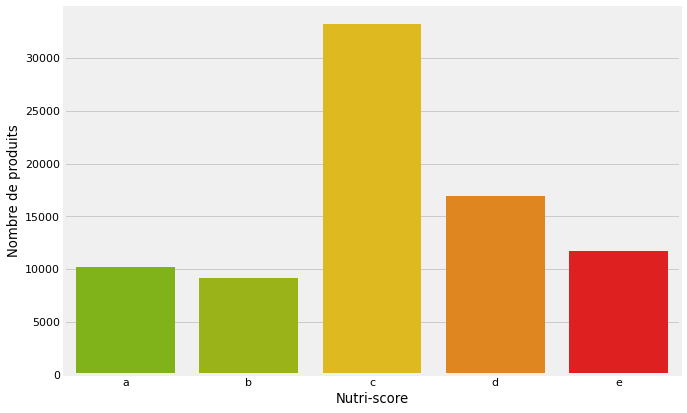

In [36]:
fig, ax = setup_figure(width=25,height=16)

qty = df.nutrition_grade_fr.value_counts().sort_index()

sns.barplot(x=qty.index, y=qty.values, palette=score_palette, ax=ax)
ax.set_xlabel("Nutri-score");
ax.set_ylabel("Nombre de produits")

# Analyse
## Catégories de produits

In [37]:
category_list = df['main_category_fr'].value_counts().nlargest(20).index
categ_count = df['categories_fr'].unique().size
print (categ_count," catégories répertoriées")

15540  catégories répertoriées


In [38]:
def display_top_n_categories(categories):
    topCateg = df['categories_fr'].str.slice(stop=50).value_counts().nlargest(categories)
    
    fig = px.bar(topCateg, x=topCateg.values,y=topCateg.index,orientation="h",
                labels={'x':'Nombre de produits', 'y':'Catégories'})
    fig.show()

interact(display_top_n_categories,categories=widgets.IntSlider(min=1, max=50, step=1, value=15,
         continuous_update=False));




interactive(children=(IntSlider(value=15, continuous_update=False, description='categories', max=50, min=1), O…

## Produits les plus sucrés
Pour 100g

In [39]:
sugar = df.sugars_100g
sugar.describe()

count    81141.000000
mean        13.260914
std         18.409803
min          0.000000
25%          1.100000
50%          4.700000
75%         16.923766
max        105.000000
Name: sugars_100g, dtype: float64

Affichage de la distribution des produits contenant des sucres

In [40]:
#sugars type ends with "ose" suffix (fructose, lactose, glucose)
sugar_list = [c for c in df.columns if ("ose_100g" in c) or ("sugars" in c) or ("carboh" in c)]

def display_sugar(sugar_type,category):
    filtered = df[df.main_category_fr==category]
    s = filtered[sugar_type]
    fig = px.histogram(filtered, x=s[s>0],nbins=100)
    fig.show()
    
    fig = px.box(sugar, x=filtered[sugar_type],orientation="h",labels={sugar_type:"Quantité"})
    fig.show()
    
    with_pics = filtered[df.image_small_url.notnull()]
    top = with_pics.nlargest(10,sugar_type)
    display_products(top,rows=4,columns=3,title_fields=['product_name',sugar_type])
    
interact(display_sugar,sugar_type=sugar_list,category = category_list);

interactive(children=(Dropdown(description='sugar_type', options=('carbohydrates_100g', 'sugars_100g', 'sucros…

## Produits energétiques

In [41]:
energetic = df.energy_100g
energetic.describe()

count    81141.000000
mean      1076.619137
std        754.349248
min          0.000000
25%        431.770378
50%       1028.520914
75%       1584.000000
max       3766.000000
Name: energy_100g, dtype: float64

In [42]:
energy_list = [c for c in df.columns if ("energy" in c) ]

def display_energy(energy_type,category):
    filtered = df[df.main_category_fr==category]
    s = filtered[energy_type]
    fig = px.histogram(df, x=s[s>0],nbins=100,labels={'x':"energie"})
    fig.show()
    
    fig = px.box(sugar, x=filtered[energy_type],orientation="h",labels={energy_type:"Quantité",'x':"energie"}, points="all")
    fig.show()
    
    with_pics = filtered[filtered.image_small_url.notnull()]
    top = with_pics.nlargest(10,energy_type)
    display_products(top,rows=4,columns=3,title_fields=['product_name',energy_type])
    
interact(display_energy,energy_type=energy_list,category=category_list);

interactive(children=(Dropdown(description='energy_type', options=('energy_100g', 'energy-from-fat_100g'), val…

## Produits les plus riches en vitamines

In [43]:
vitamin_list = []
for column in df.columns:
    if "vitamin" in column:
        vitamin_list.append(column)


def display_vitamin(vitamin_type,category):
    filtered = df[df.main_category_fr==category]
    s = filtered[vitamin_type]
    fig = px.histogram(filtered, x=s[s>0],nbins=100,labels={'x':vitamin_type})
    fig.show()
    
    fig = px.box(sugar, x=filtered[vitamin_type],orientation="h",labels={'x':"Vitamines",'color':"Nutri score"}, points="all",
                color=filtered.nutrition_grade_fr,color_discrete_sequence=score_palette)
    fig.show()
    
    with_pics = filtered[filtered.image_small_url.notnull()]
    top = with_pics.nlargest(10,vitamin_type)
    display_products(top,rows=4,columns=3,title_fields=['product_name',vitamin_type])
    
interact(display_vitamin,vitamin_type=vitamin_list,category=category_list);

interactive(children=(Dropdown(description='vitamin_type', options=('vitamin-a_100g', 'vitamin-d_100g', 'vitam…

## Répartition du score en fonction de l'energie et du sucre

In [44]:

df = df.sort_values(by=['nutrition_grade_fr'])
fig = px.scatter(df, x="sugars_100g", y="energy_100g", color="nutrition_grade_fr",color_discrete_sequence=score_palette,
                 hover_data=['energy_100g'],labels={"sugars_100g":"Sucre (100g)","energy_100g":"Energie (100g)",
                                                   "nutrition_grade_fr":"Nutri-Score"})
fig.show()

In [45]:
fig = px.density_contour(df, x="sugars_100g", y="energy_100g")
fig.update_traces(contours_coloring="fill", contours_showlabels = True)
fig.show()

## Produits gras

In [46]:
fat_list = [c for c in df.columns if ("fat" in c) ]

def display_fat(fat_type,category):
    filtered = df[df.main_category_fr==category]
    s = filtered[fat_type]
    fig = px.histogram(filtered, x=s[s>0],nbins=100,labels={'x':fat_type})
    fig.show()
    
    fig = px.box(sugar, x=filtered[fat_type],orientation="h",labels={'x':fat_type,'color':"Nutri score"}, points="all",
                color=filtered.nutrition_grade_fr,color_discrete_sequence=score_palette)
    fig.show()
    
    with_pics = filtered[filtered.image_small_url.notnull()]
    top = with_pics.nlargest(10,fat_type)
    display_products(top,rows=4,columns=3,title_fields=['product_name',fat_type])
    
interact(display_fat,fat_type=fat_list,category=category_list);

interactive(children=(Dropdown(description='fat_type', options=('energy-from-fat_100g', 'fat_100g', 'saturated…

## Produits salés

In [47]:
salt_list = [c for c in df.columns if ("salt" in c) ]

def display_salt(category):
    filtered = df[df.main_category_fr==category]

    fig = px.histogram(filtered, x='salt_100g',nbins=100,labels={'x':'Teneur en sel'})
    fig.show()
    
    fig = px.box(filtered, x='salt_100g',orientation="h",
                 labels={'x':'Teneur en sel','color':"Nutri score"}, points="all",
                 color=filtered.nutrition_grade_fr,color_discrete_sequence=score_palette)
    fig.show()
    
    with_pics = filtered[filtered.image_small_url.notnull()]
    top = with_pics.nlargest(10,'salt_100g')
    display_products(top,rows=4,columns=3,title_fields=['product_name','salt_100g'])
    
interact(display_salt,category=category_list);

interactive(children=(Dropdown(description='category', options=('Boissons', 'Epicerie', 'Conserves', 'Chocolat…

## Recherche de produits par nutri-score et un critère

In [48]:
score_list = VALID_SCORES
comparison_type_list = ['largest','smallest']
field_list = []
for c in df.columns:
    if df[c].dtype not in ['object']:
        field_list.append(c)
    
def display_products_by_score(nutri_score,critere,comparison_type):
    products = df[(df.nutrition_grade_fr==nutri_score)&(df.image_small_url)]
    if comparison_type=='largest':
        top = products.nlargest(12,critere)
    else:
        top = products.nsmallest(12,critere)
    display_products(top,rows=4,columns=3,title_fields=[critere])

interact(display_products_by_score, nutri_score=score_list,critere=field_list,comparison_type=comparison_type_list);

interactive(children=(Dropdown(description='nutri_score', options=('a', 'b', 'c', 'd', 'e'), value='a'), Dropd…

## Recherche du score du produit en fonction de sa teneur en graisse et sucre

In [49]:
sug = df.sort_values(by=['nutrition_grade_fr'])

fat_list = [c for c in df.columns if ("fat" in c) ]
sugar_list = [c for c in df.columns if ("ose_100g" in c) or ("sugars" in c) or ("carboh" in c)]

def display_sugar_fat(sugar_type,fat_type):
    

    fig = px.scatter(sug, x=sugar_type, y=fat_type, color="nutrition_grade_fr",color_discrete_sequence=score_palette,
                 hover_data=[fat_type],labels={"sugars_100g":"Sucre (100g)","fat_100g":"Graisse (100g)",
                                                   "nutrition_grade_fr":"Nutri-Score"})
    fig.show()
    
interact(display_sugar_fat, sugar_type=sugar_list,fat_type=fat_list);

interactive(children=(Dropdown(description='sugar_type', options=('carbohydrates_100g', 'sugars_100g', 'sucros…

## Etude du nutriscore en fonction de 2 paramètres

In [50]:
field_list = []
for column in df.columns:
    if "_100g" in column:
        field_list.append(column)

def display_score_with_parameters(x,y):
    d=df.sort_values(by=["nutrition_grade_fr"])
    d=d[d[x].between(0, d[x].quantile(.75), inclusive=True)]
    d=d[d[y].between(0, d[y].quantile(.75), inclusive=True)]
    sns.relplot(x=x, y=y,data=d,hue="nutrition_grade_fr",palette=score_palette,height=12)

interact(display_score_with_parameters, x=field_list,y=field_list);



interactive(children=(Dropdown(description='x', options=('energy_100g', 'energy-from-fat_100g', 'fat_100g', 's…

## Gras et salé

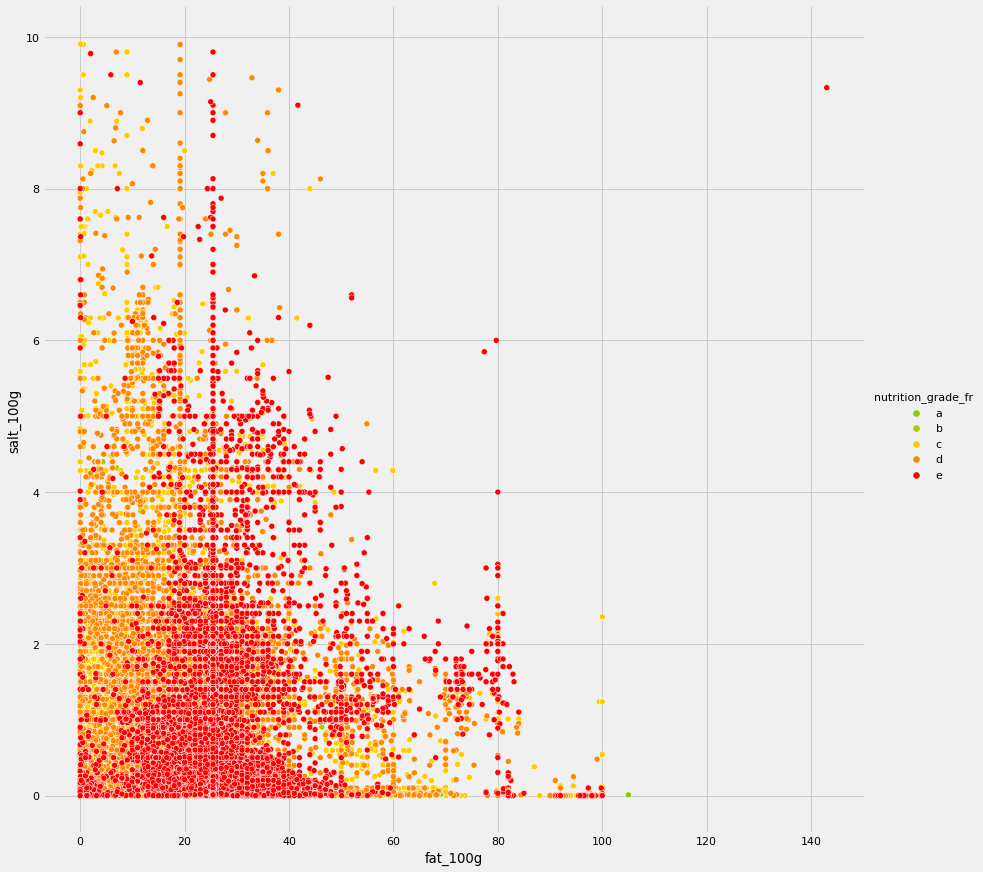

In [51]:
salt = df[df.salt_100g<10]

sns.relplot(x="fat_100g", y="salt_100g",data=salt,hue="nutrition_grade_fr",palette=score_palette,height=12)

## Teneur en Magnesium et Phosphore

In [52]:
fig = px.scatter(sug, x="magnesium_100g", y="phosphorus_100g", color="nutrition_grade_fr",color_discrete_sequence=score_palette,
                 hover_data=['magnesium_100g'],labels={"nutrition_grade_fr":"Nutri-Score"})
fig.show()

## Teneur en sel et sodium

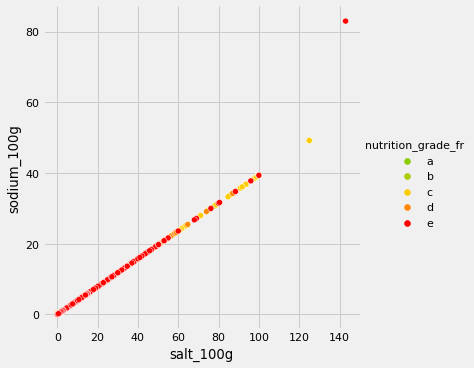

In [53]:
p =sns.relplot(x="salt_100g", y="sodium_100g",data=df,hue="nutrition_grade_fr",palette=score_palette)
a = p.axes

On voit que les variables sont liées, on effectue une regression linéaire pour trouver le coef

In [54]:
Y = df['sodium_100g']
X = df[['salt_100g']]
X = X.copy() # On modifiera X, on en crée donc une copie
X['intercept'] = 1.
result = sm.OLS(Y, X).fit() # OLS = Ordinary Least Square (Moindres Carrés Ordinaire)
a,b = result.params['salt_100g'],result.params['intercept']

print ("Teneur en sel =",1/a,"x celle en sodium... et b=",b," proche de 0")

Teneur en sel = 2.526152842219573 x celle en sodium... et b= -0.0023213262704846332  proche de 0


## Test de significativité sel/sodium

Sur l'échantillon concerné le coefficient de correlation est proche de 1 avec une p-value nulle

On étudie le distribution

In [55]:
fig = px.histogram(df, x="salt_100g")
fig.show()

fig = px.histogram(df, x="sodium_100g")
fig.show()

In [56]:
sample = df.iloc[:]

#Test de normalité
k2, p = stats.normaltest(sample.salt_100g.tolist())
print("Normalité distribution du sel: ",p)

k2, p = stats.normaltest(sample.sodium_100g.tolist())
print("Normalité distribution du sodium: ",p)


#Test de significativité : p_value inférieure à 0.1%
cor, p_value = stats.pearsonr(sample.salt_100g.tolist(), sample.sodium_100g.tolist())
print('Coefficient de correlation:',cor,' p_value=',p_value)


Normalité distribution du sel:  0.0
Normalité distribution du sodium:  0.0
Coefficient de correlation: 0.9987192168324204  p_value= 0.0


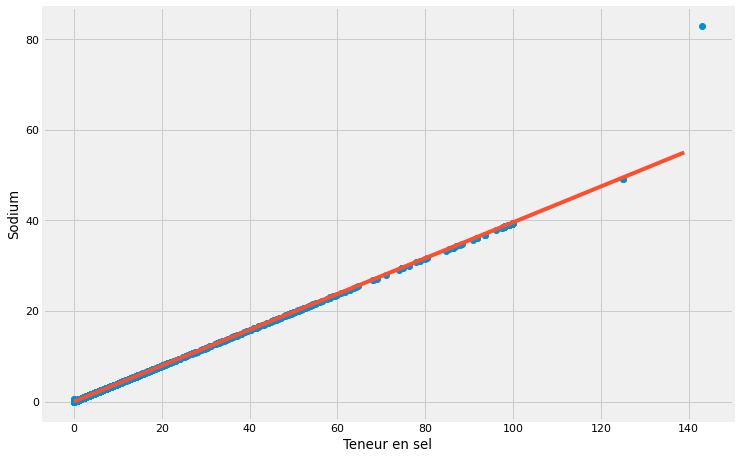

In [57]:
setup_figure()
plt.plot(df.salt_100g,df.sodium_100g, "o")
plt.plot(np.arange(140),[a*x+b for x in np.arange(140)])
plt.xlabel("Teneur en sel")
plt.ylabel("Sodium")
plt.show()

## Score en fonction de la teneur en sel

In [58]:
fig = px.scatter(df, x="nutrition-score-fr_100g", y="salt_100g",
                 color="nutrition_grade_fr",color_discrete_sequence=score_palette,opacity=0.5,
                 labels={"nutrition_grade_fr":"Nutri-Score"})
fig.show()

## Score en fonction de la teneur en sucre

In [59]:
fig = px.scatter(df, x="sugars_100g", y="nutrition-score-fr_100g",
                 color="nutrition_grade_fr",color_discrete_sequence=score_palette,opacity=0.5,
                 labels={"nutrition_grade_fr":"Nutri-Score"})
fig.show()

## Score en fonction de la teneur en graisses saturées

In [60]:
fig = px.scatter(df, x="saturated-fat_100g", y="nutrition-score-fr_100g",
                 color="nutrition_grade_fr",color_discrete_sequence=score_palette,opacity=0.5,
                 labels={"nutrition_grade_fr":"Nutri-Score"})
fig.show()

## Score en fonction de l'energie

In [61]:
fig = px.scatter(df, x="energy_100g", y="nutrition-score-fr_100g",
                 color="nutrition_grade_fr",color_discrete_sequence=score_palette,opacity=0.5,
                 labels={"nutrition_grade_fr":"Nutri-Score"})
fig.show()

## Association nutriscore lettre / score numérique

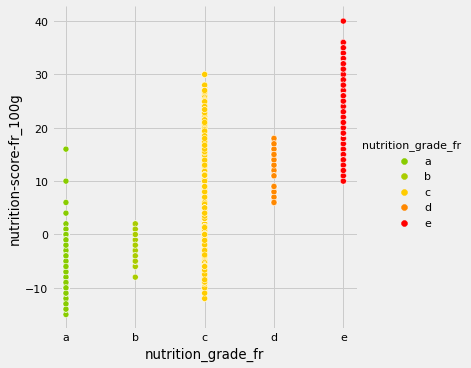

In [62]:
c = df.sort_values('nutrition_grade_fr')
p =sns.relplot(x="nutrition_grade_fr", y="nutrition-score-fr_100g",data=c,hue="nutrition_grade_fr",palette=score_palette)
a = p.axes

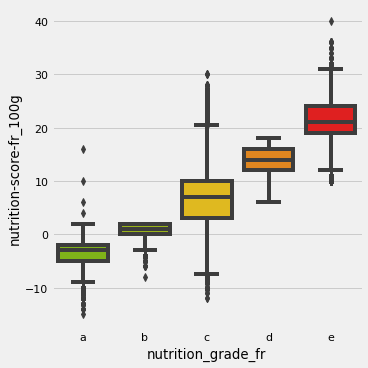

In [63]:
c = df.sort_values('nutrition_grade_fr')
#sns.distplot(df["nutrition-score-fr_100g"], bins=40)
sns.catplot(x="nutrition_grade_fr", y="nutrition-score-fr_100g", kind="box", data=c,palette=score_palette);
a = p.axes

## Analyse d'un champ par catégorie de produits (ANOVA)

In [64]:
frequent_categories = df['main_category_fr'].value_counts().nlargest(20).index
filtered = df[df['main_category_fr'].isin(frequent_categories)]


columns = [c for c in df.columns if df.dtypes[c] in ['int64','float64'] ]


def eta_squared(x,y):
    moyenne_y = y.mean()
    classes = []
    for classe in x.unique():
        yi_classe = y[x==classe]
        classes.append({'ni': len(yi_classe),
                        'moyenne_classe': yi_classe.mean()})
    SCT = sum([(yj-moyenne_y)**2 for yj in y])
    SCE = sum([c['ni']*(c['moyenne_classe']-moyenne_y)**2 for c in classes])
    return SCE/SCT


           
def anova_by_category(column):
    X = "main_category_fr" # qualitative
    print("Correlation :",eta_squared(filtered[X],filtered[column]))
    #sns.catplot(x=column, y="main_category_fr", kind="box", data=filtered,height=15,aspect=1);
    fig = px.box(filtered, x=filtered[column],y="main_category_fr",labels={'main_category_fr':"Catégories"},
                 color="main_category_fr",orientation="h",height=800,boxmode="overlay")
    fig.update_layout(showlegend=False,boxgap=0.3,boxgroupgap=0)
    fig.show();
    

interact(anova_by_category,column=columns)

interactive(children=(Dropdown(description='column', options=('additives_n', 'ingredients_from_palm_oil_n', 'e…

<function __main__.anova_by_category(column)>

### Etude des boissons peu sucrée et riche en fruits / légumes

In [65]:
boissons = df[df.main_category_fr=="Boissons"]

print(len(boissons.index),' produits')
print("Jusqu'à ",boissons.sugars_100g.max(),' g de sucres')
print("Jusqu'à ",boissons.additives_n.max(),' additifs')

fig = px.scatter(boissons, x="sugars_100g", y="fruits-vegetables-nuts_100g", color="nutrition_grade_fr",color_discrete_sequence=score_palette,
                 hover_data=['fruits-vegetables-nuts_100g'],labels={"sugars_100g":"Sucre (100g)",
                                                   "fruits-vegetables-nuts_100g":"Teneur en fruits et légumes"})
fig.show()

4429  produits
Jusqu'à  94.0  g de sucres
Jusqu'à  11.0  additifs


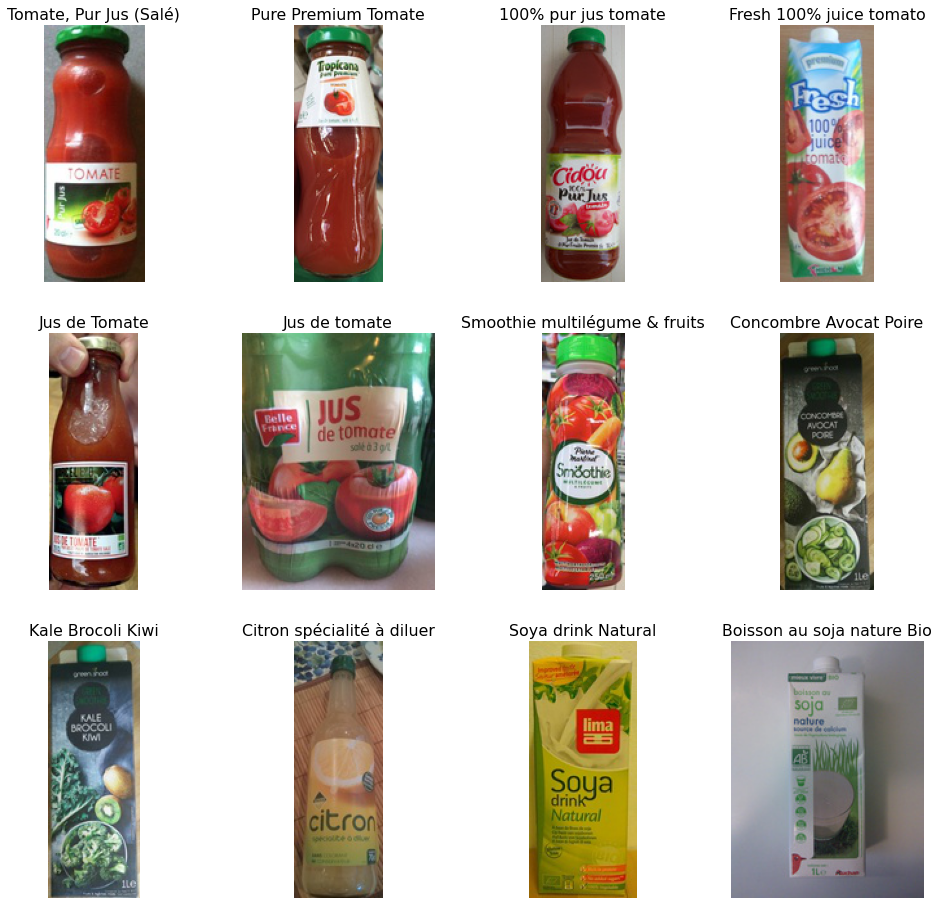

,code,product_name,categories_fr,nutrition_grade_fr,additives_fr,energy_100g,sugars_100g,fat_100g,salt_100g,fruits-vegetables-nuts_100g
245240,3596710259151,"Tomate, Pur Jus (Salé)","Aliments et boissons à base de végétaux,Boissons,Aliments d'origine végétale...",b,NaN,86.000,3.500,0.100,0.630000,100.000000
278100,5410188014211,Pure Premium Tomate,"Aliments et boissons à base de végétaux,Boissons,Aliments d'origine végétale...",b,NaN,71.000,3.200,0.000,1.524000,100.000000
254905,3760225491225,100% pur jus tomate,"Aliments et boissons à base de végétaux,Boissons,Aliments d'origine végétale...",b,NaN,70.000,2.700,0.500,0.400000,100.000000
255640,3800014284284,Fresh 100% juice tomato,"Aliments et boissons à base de végétaux,Boissons,Aliments d'origine végétale...",c,NaN,75.625,3.125,0.275,0.593500,100.000000
250790,3700749300177,Jus de Tomate,"Aliments et boissons à base de végétaux,Boissons,Aliments d'origine végétale...",c,NaN,75.625,3.125,0.275,0.593500,100.000000
213521,3258561301129,Jus de tomate,"Aliments et boissons à base de végétaux,Boissons,Aliments d'origine végétale...",c,NaN,75.625,3.125,0.275,0.593500,100.000000
222481,3281780878905,Smoothie multilégume & fruits,"Aliments et boissons à base de végétaux,Boissons,Boissons à base de végétaux...",d,NaN,105.000,4.500,0.500,0.630000,100.000000
253860,3760132081991,Concombre Avocat Poire,"Aliments et boissons à base de végétaux,Boissons,Boissons à base de végétaux...",d,NaN,139.000,4.400,0.900,0.030000,80.000000
253859,3760132081960,Kale Brocoli Kiwi,"Aliments et boissons à base de végétaux,Boissons,Boissons à base de végétaux...",c,NaN,101.000,4.300,0.200,0.030000,60.000000
216342,3263857092018,Citron spécialité à diluer,"Boissons,Sirops,Sirops aromatisés,Sirops de citron,Boissons non sucrées,Bois...",c,NaN,91.000,1.030,0.000,0.007620,41.000000


In [66]:
b = boissons[(boissons.image_small_url.notnull())&(boissons['sugars_100g']<5)&(boissons.additives_n==0)]
top = b.nlargest(12,'fruits-vegetables-nuts_100g')
display_products(top,rows=3,columns=4)

### Etude des chocolats peu sucrés et avec peu de graisses saturées

Jusqu'à  83.0  g de sucres
Jusqu'à  16.0  additifs
Jusqu'à  41.0  g de graisses saturées


/home/smougel/.conda/envs/eda_open_food_facts/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



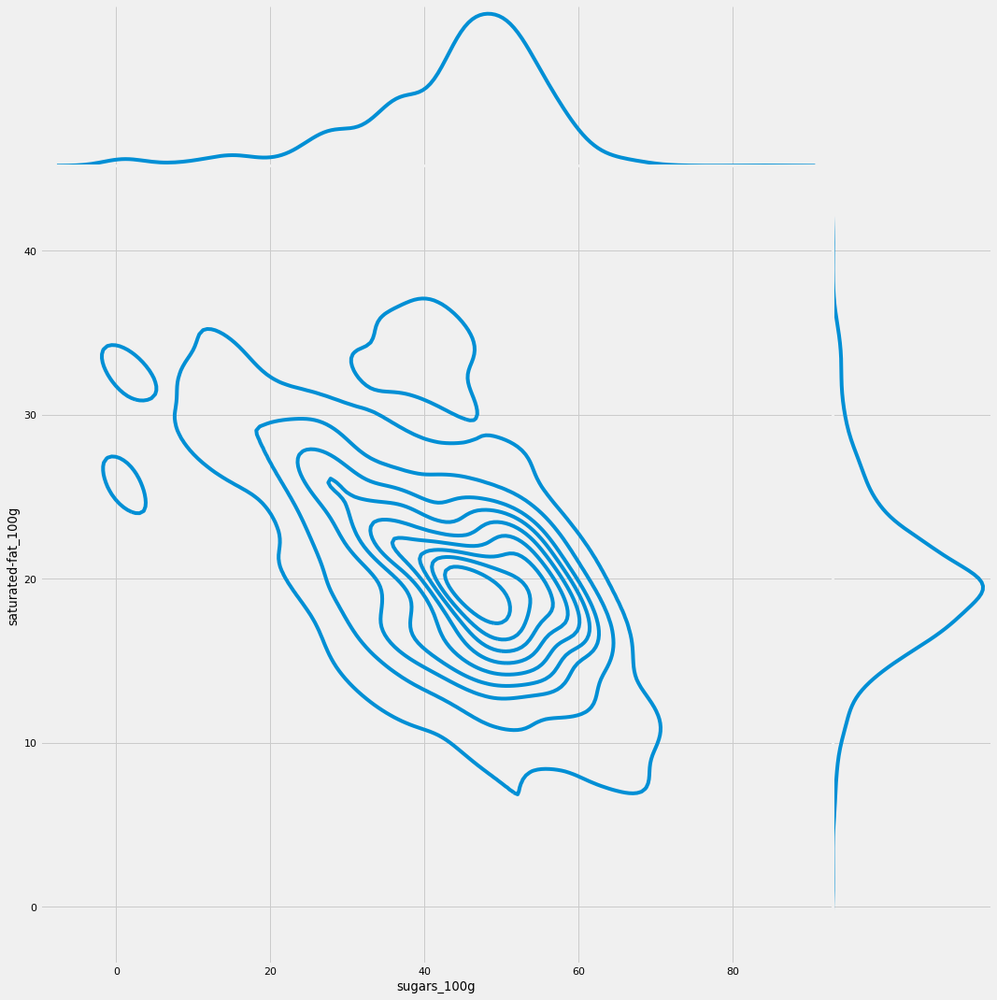

In [67]:
products = df[(df.main_category_fr=="Chocolats")]

print("Jusqu'à ",products.sugars_100g.max(),' g de sucres')
print("Jusqu'à ",products.additives_n.max(),' additifs')
print("Jusqu'à ",products['saturated-fat_100g'].max(),' g de graisses saturées')
#cocoa_100g
g = sns.jointplot(products['sugars_100g'], products['saturated-fat_100g'], kind="kde", height=15, space=0)

Erreur lors de la lecture de cette url : nan
Erreur lors de la lecture de cette url : nan
Erreur lors de la lecture de cette url : nan


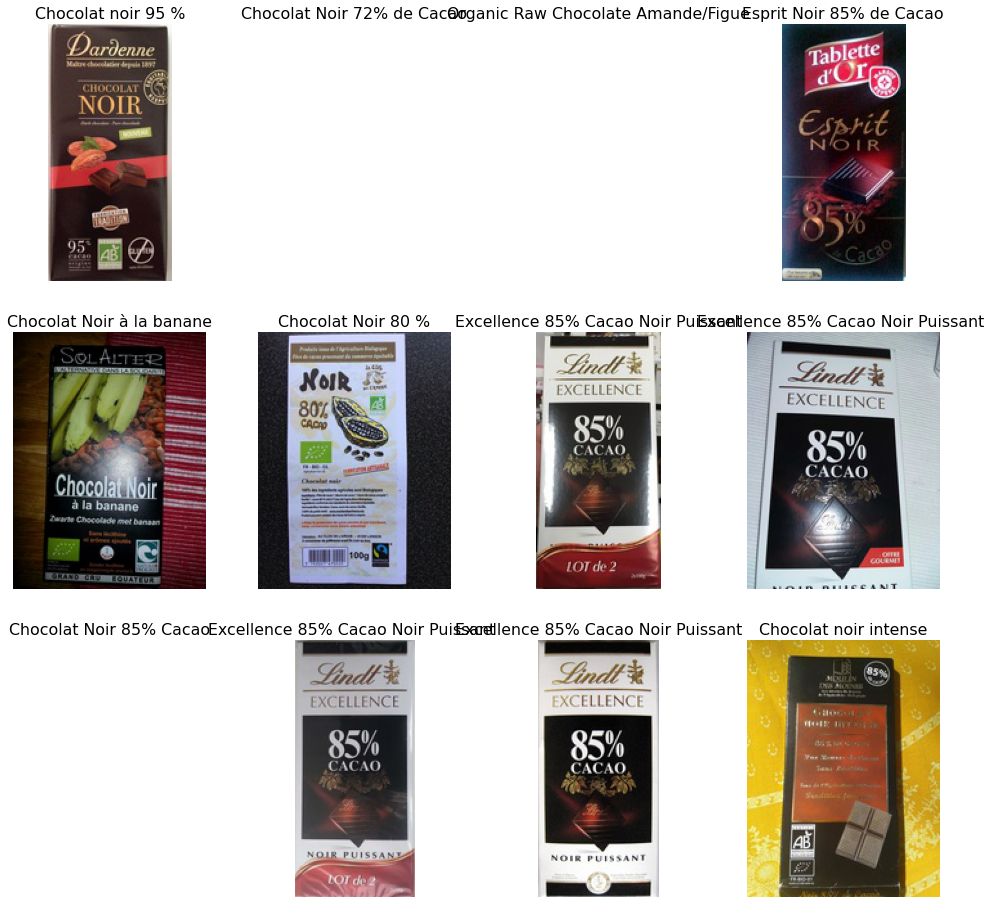

,code,product_name,categories_fr,nutrition_grade_fr,additives_fr,energy_100g,sugars_100g,fat_100g,salt_100g,fruits-vegetables-nuts_100g,additives_n,labels,cocoa_100g
213740,3258590001373,Chocolat noir 95 %,"Snacks sucrés,Chocolats,Chocolats noirs",d,NaN,2641.0,7.6,51.800000,0.10000,30.000000,0.0,"Peu ou pas de sel,Sans gluten,Sans sel ajouté,AB Agriculture Biologique,Vega...",95.00000
218183,3266191104072,Chocolat Noir 72% de Cacao,"Snacks sucrés,Chocolats,Chocolats noirs,Chocolats noirs extra fin",d,NaN,2339.0,16.0,45.000000,0.01000,26.102345,0.0,"Peu ou pas de sucre,Peu de sucre,Bio,Bio européen,Allégé en sucre,CH-BIO-006...",72.00000
315648,8718421151738,Organic Raw Chocolate Amande/Figue,"Snacks sucrés,Chocolats,Chocolats avec amandes,Chocolats noirs,Chocolats noi...",e,NaN,2454.0,17.8,46.100000,0.12000,26.102345,0.0,"Bio,Végétarien,Bio européen,Végétalien,NL-BIO-01,Agriculture UE/Non UE,Sans ...",80.00000
241430,3564700257647,Esprit Noir 85% de Cacao,"Snacks sucrés,Chocolats,Chocolats noirs,Chocolats noirs extra fin",d,NaN,2364.0,15.9,43.400000,0.02000,26.102345,0.0,Pur beurre de cacao,85.00000
254325,3760170551401,Chocolat Noir à la banane,"Snacks sucrés,Chocolats,Chocolats noirs,en:Chocolats-noirs-extra-fin",c,NaN,2413.0,11.0,46.000000,0.02000,26.102345,0.0,"No flavors,No lecithine,Nature & Progrès",65.00000
251727,3760027470220,Chocolat Noir 80 %,"Snacks sucrés,Chocolats,Chocolats noirs",d,NaN,2218.0,14.0,37.548333,0.08000,30.000000,0.0,"Bio,Bio européen,FR-BIO-01,AB Agriculture Biologique,Fairtrade",80.00000
191250,3046920029971,Excellence 85% Cacao Noir Puissant,"Snacks sucrés,Chocolats,Chocolats noirs,Chocolats noirs extra fin",e,NaN,2210.0,14.0,46.000000,0.08000,26.102345,0.0,NaN,85.00000
191304,3046920057721,Excellence 85% Cacao Noir Puissant (offre gourmet),"Snacks sucrés,Chocolats,Chocolats noirs,Chocolats noirs extra fin",e,NaN,2210.0,14.0,46.000000,0.08000,26.102345,0.0,NaN,85.00000
191206,3046920022606,Chocolat Noir 85% Cacao,"Snacks sucrés,Chocolats,Chocolats noirs,en:Chocolats-noirs-extra-fin",e,NaN,2413.0,11.0,46.000000,0.02000,26.102345,0.0,NaN,85.00000
191233,3046920027953,Excellence 85% Cacao Noir Puissant LOT de 2,"Snacks sucrés,Chocolats,Chocolats noirs,Chocolats noirs extra fin",e,NaN,2210.0,14.0,46.000000,0.08000,26.102345,0.0,NaN,63.78125


In [68]:
filtered = products[(products['sugars_100g']<20) & (products.additives_n==0)]
top = filtered.nsmallest(12,'saturated-fat_100g')
display_products(top,rows=3,columns=4,title_fields=['cocoa_100g','additives_n','labels'])


### Produits du petit déjeuner
Sans additifs et faibles en sucre

/home/smougel/.conda/envs/eda_open_food_facts/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



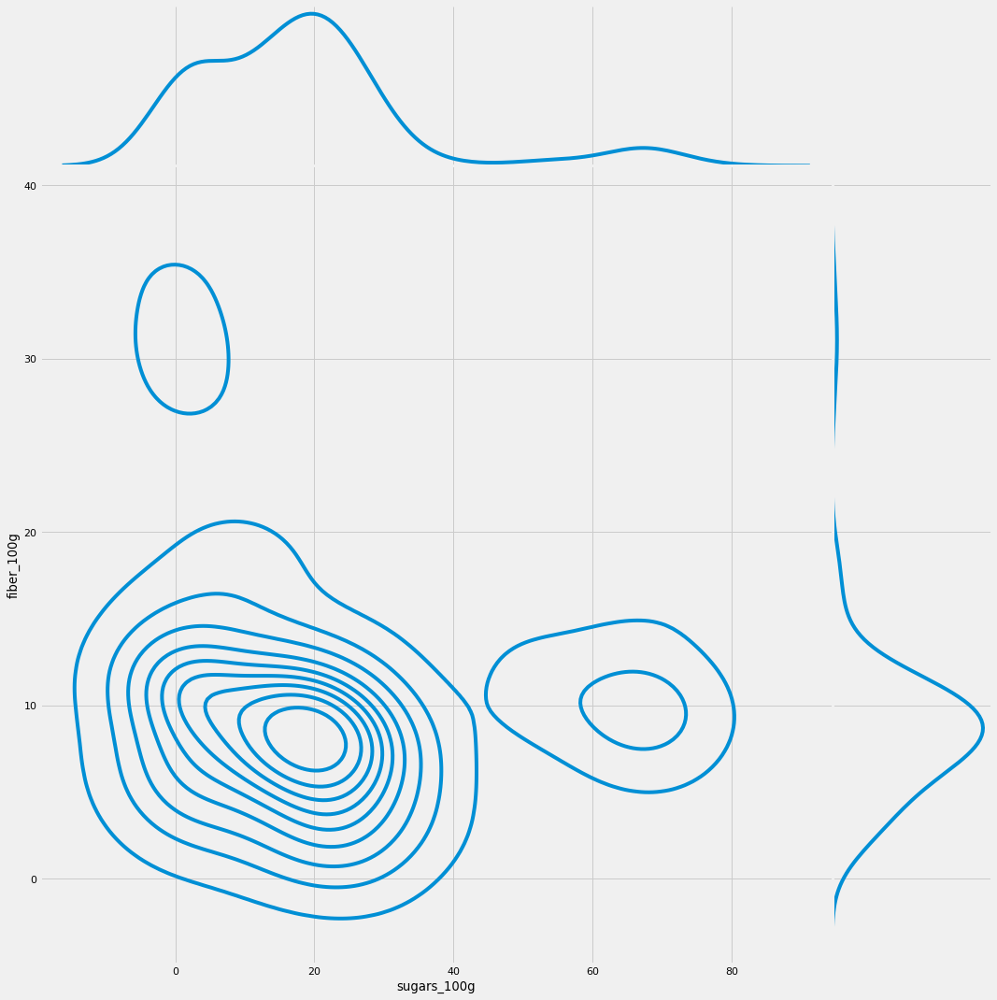

In [69]:
products = df[(df.main_category_fr=="Petit-déjeuners") & (df.additives_n==0) & 
              (df.labels.str.contains('bio',case=False, regex=False))]
#boissons['fruits-vegetables-nuts_100g'].describe()
g = sns.jointplot(products['sugars_100g'], products['fiber_100g'], kind="kde", height=15, space=0)

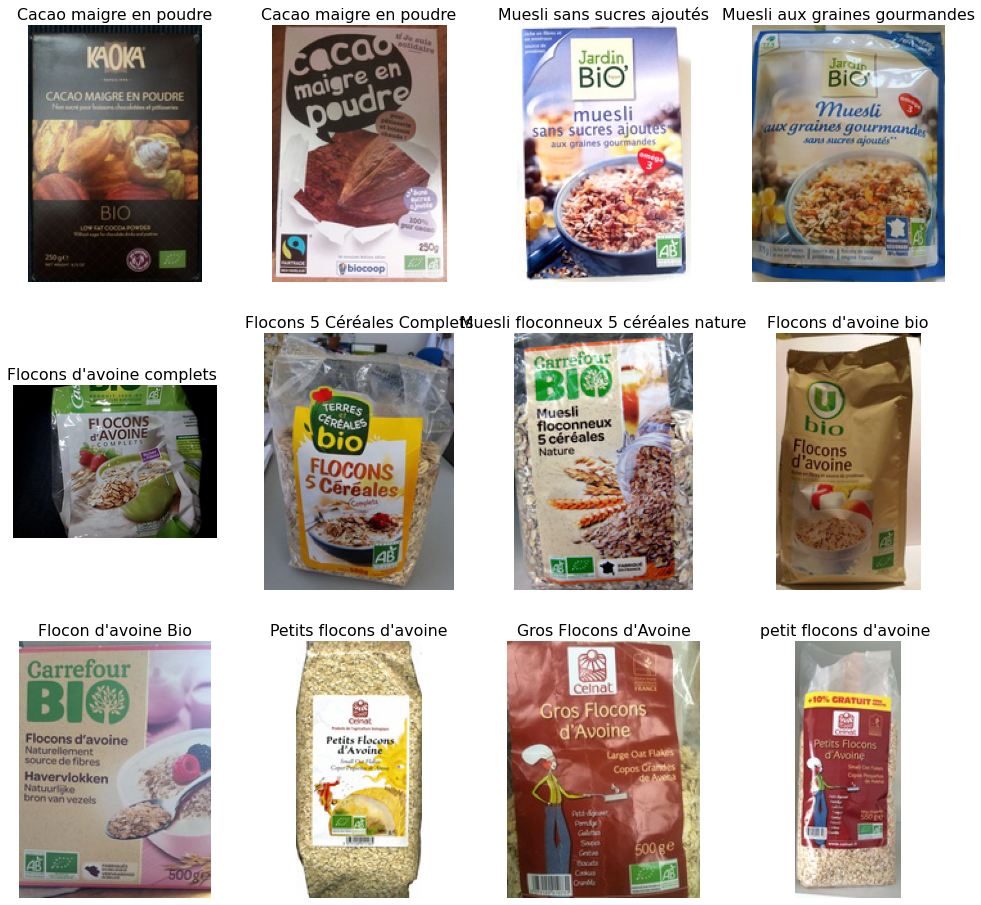

,code,product_name,categories_fr,nutrition_grade_fr,additives_fr,energy_100g,sugars_100g,fat_100g,salt_100g,fruits-vegetables-nuts_100g,fiber_100g
234862,3477730009011,Cacao maigre en poudre,"Petit-déjeuners,Snacks sucrés,Chocolats,Chocolats en poudre",b,NaN,1395.0,1.0,11.0,0.04826,10.927833,30.0
253500,3760121210227,Cacao maigre en poudre,"Petit-déjeuners,Snacks sucrés,Chocolats,Chocolats en poudre",a,NaN,1275.0,2.0,11.0,0.17000,10.927833,27.5
234903,3478820008006,Muesli sans sucres ajoutés,"Aliments et boissons à base de végétaux,Aliments d'origine végétale,Petit-dé...",a,NaN,1592.0,9.5,10.7,0.02540,22.900000,18.4
251400,3760020503802,Muesli aux graines gourmandes,"Aliments et boissons à base de végétaux,Aliments d'origine végétale,Petit-dé...",a,NaN,1592.0,9.5,10.7,0.03000,22.900000,18.4
201481,3222475651298,Flocons d'avoine complets,"Aliments et boissons à base de végétaux,Aliments d'origine végétale,Petit-dé...",a,NaN,1525.0,4.2,7.9,0.00000,10.927833,16.0
232102,3421557910173,Flocons 5 Céréales Complets,"Aliments et boissons à base de végétaux,Aliments d'origine végétale,Petit-dé...",a,NaN,1414.0,1.8,3.2,0.01000,10.927833,14.4
238649,3560070519309,Muesli floconneux 5 céréales nature Bio,"Aliments et boissons à base de végétaux,Aliments d'origine végétale,Petit-dé...",a,NaN,1397.0,1.8,3.2,0.01000,22.900000,14.0
210202,3256221407242,Flocons d'avoine bio,"Aliments et boissons à base de végétaux,Aliments d'origine végétale,Petit-dé...",a,NaN,1501.0,1.0,6.5,0.00000,10.927833,12.0
238289,3560070407613,Flocon d'avoine Bio,"Aliments et boissons à base de végétaux,Aliments d'origine végétale,Petit-dé...",a,NaN,1460.0,1.0,6.5,0.03000,0.000000,12.0
220767,3273120011165,Petits flocons d'avoine,"Aliments et boissons à base de végétaux,Aliments d'origine végétale,Petit-dé...",a,NaN,1577.0,1.0,7.1,0.01000,10.927833,11.5


In [70]:
p = products[(products.image_small_url.notnull())&(products['sugars_100g']<10)]
top = p.nlargest(12,'fiber_100g')
display_products(top,rows=3,columns=4,title_fields=['fiber_100g'])

### Pâtes

228  Produits
Jusqu'à  2.0  g de sel
Jusqu'à  0.0  additifs
Jusqu'à  10.4  g de graisses sat
Jusqu'à  5.8  g de graisses sat


/home/smougel/.conda/envs/eda_open_food_facts/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



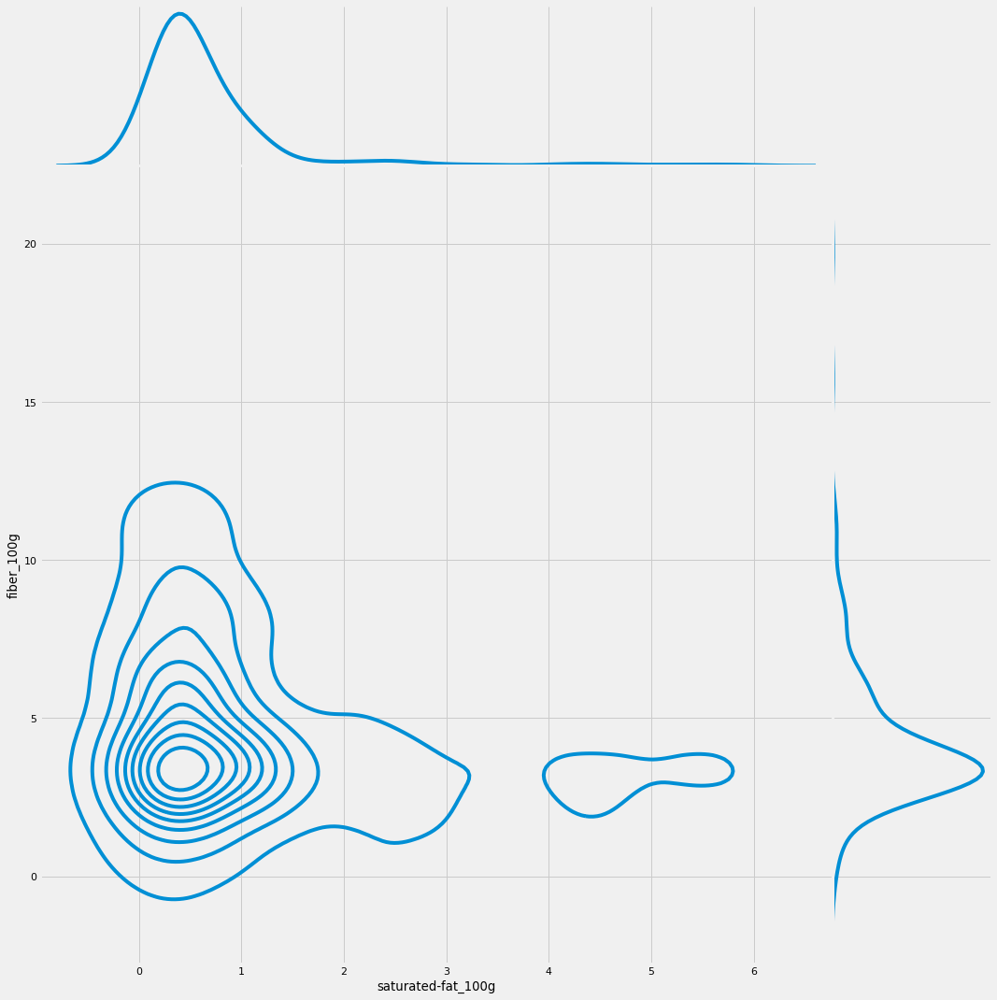

In [71]:
products = df[(df.main_category_fr=="Pâtes alimentaires") &(df.additives_n==0)&(df.labels.str.contains('bio',case=False, regex=False))]

print(len(products.index),' Produits')

print("Jusqu'à ",products.salt_100g.max(),' g de sel')
print("Jusqu'à ",products.additives_n.max(),' additifs')
print("Jusqu'à ",products['fat_100g'].max(),' g de graisses sat')
print("Jusqu'à ",products['saturated-fat_100g'].max(),' g de graisses sat')



fig = px.box(products, x='saturated-fat_100g',y="nutrition_grade_fr",
             labels={'nutrition_grade_fr':"Nutri-score","saturated-fat_100g":"Teneur en graisses saturées pour 100g"},
             color="nutrition_grade_fr",color_discrete_sequence=score_palette,
             orientation="h",height=800,boxmode="overlay")
fig.show()
fig = px.box(products, x='fiber_100g',y="nutrition_grade_fr",
             labels={'nutrition_grade_fr':"Nutri-score","fiber_100g":"Teneur en fibres pour 100g"},
             color="nutrition_grade_fr",color_discrete_sequence=score_palette,
             orientation="h",height=800,boxmode="overlay")
fig.show()
g = sns.jointplot(products['saturated-fat_100g'], products['fiber_100g'], kind="kde", height=15, space=0)

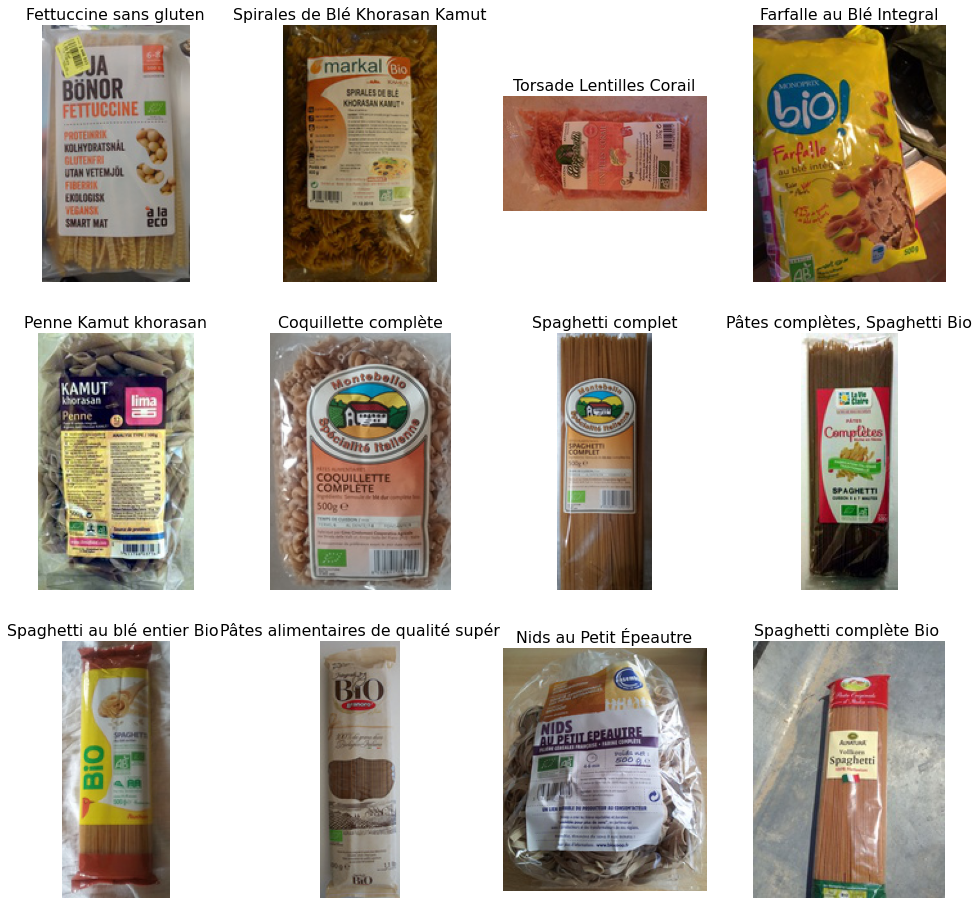

,code,product_name,categories_fr,nutrition_grade_fr,additives_fr,energy_100g,sugars_100g,fat_100g,salt_100g,fruits-vegetables-nuts_100g
285436,7340084860132,Fettuccine sans gluten,"Aliments et boissons à base de végétaux,Aliments d'origine végétale,Céréales...",a,NaN,1352.0,11.500000,4.000000,0.01524,9.621429
225235,3329489521156,Spirales de Blé Khorasan Kamut,"Aliments et boissons à base de végétaux,Aliments d'origine végétale,Céréales...",a,NaN,1427.0,3.500000,3.000000,0.02000,9.621429
218493,3267460030214,Torsade Lentilles Corail,"Aliments et boissons à base de végétaux,Aliments d'origine végétale,Céréales...",a,NaN,1397.0,1.900000,3.175307,0.02000,9.621429
227520,3350031904387,Farfalle au Blé Integral,"Aliments et boissons à base de végétaux,Aliments d'origine végétale,Céréales...",a,NaN,1461.0,3.100000,2.100000,0.02000,9.621429
279182,5411788037167,Penne Kamut khorasan,"Aliments et boissons à base de végétaux,Aliments d'origine végétale,Céréales...",a,NaN,1413.0,4.000000,1.200000,0.01000,9.621429
305033,8032891769294,Coquillette complète,"Aliments et boissons à base de végétaux,Aliments d'origine végétale,Céréales...",a,NaN,1510.0,3.800000,6.688889,0.08000,9.621429
305031,8032891769270,Spaghetti complet,"Aliments et boissons à base de végétaux,Aliments d'origine végétale,Céréales...",a,NaN,1510.0,3.800000,3.175307,0.08000,9.621429
217980,3266191012308,"Pâtes complètes, Spaghetti Bio","Aliments et boissons à base de végétaux,Aliments d'origine végétale,Céréales...",a,NaN,1453.0,5.000000,2.700000,0.00600,9.621429
245856,3596710347209,Spaghetti au blé entier Bio,"Aliments et boissons à base de végétaux,Aliments d'origine végétale,Céréales...",a,NaN,1454.0,3.000000,2.200000,0.02000,9.621429
303402,8007290335005,Pâtes alimentaires de qualité supérieure de blé entier BIOLOGIQUE,"Aliments et boissons à base de végétaux,Aliments d'origine végétale,Céréales...",a,NaN,1487.0,3.400000,2.400000,0.00000,9.621429


In [72]:
p = products[(products.image_small_url.notnull())&(products['sodium_100g']<0.1)]
top = p.nlargest(12,'fiber_100g')
display_products(top,rows=3,columns=4)

### Laits (Bio)
Nous manquons d'omega 3 et consommons trop d'omega 6 dans notre alimentation... 
Privilègions un type de lait :
- riche en omega-3
- avec le moins de graisses saturées

In [73]:
products = df[(df.main_category_fr=="Laits")&(df.labels.str.contains('bio',case=False, regex=False))]

fig = px.density_contour(products, x="saturated-fat_100g", y="omega-3-fat_100g")
fig.update_traces(contours_coloring="fill", contours_showlabels = True)
fig.update_layout(xaxis=dict(range=[0, products['saturated-fat_100g'].max()]))
#fig.update_layout(yaxis=dict(range=[0, products['omega-3-fat_100g'].max()]))
fig.show()

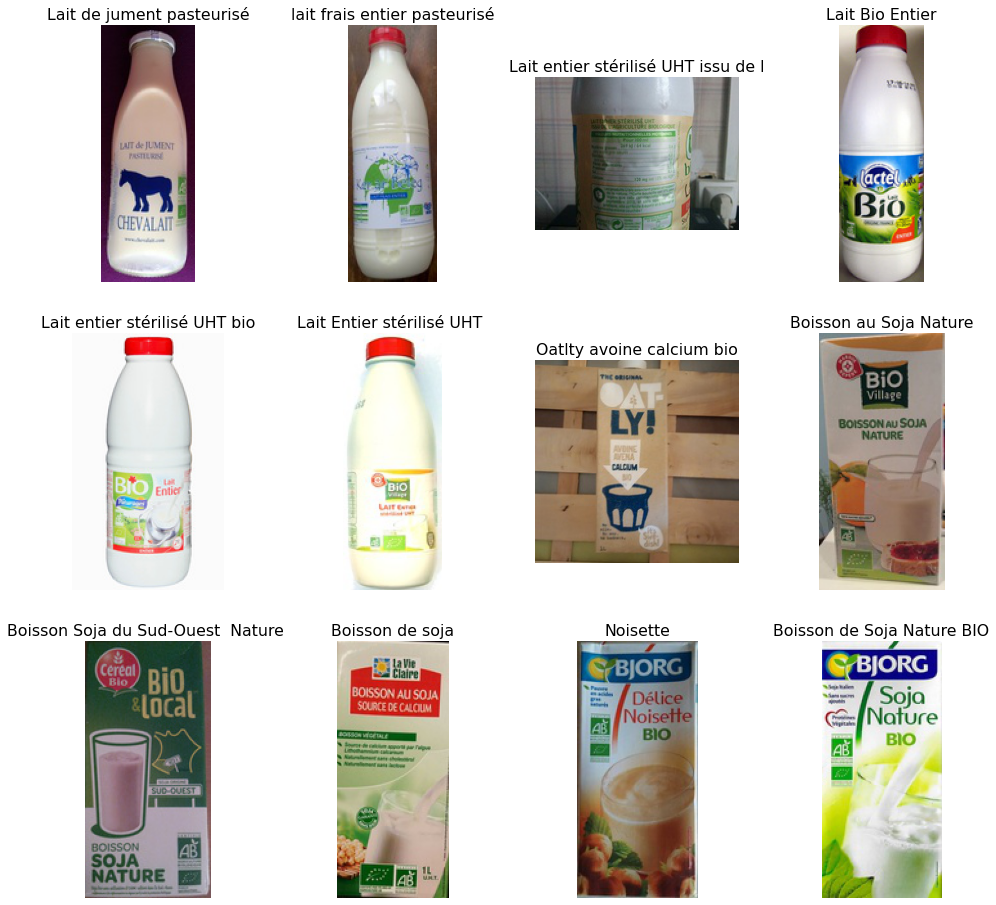

,code,product_name,categories_fr,nutrition_grade_fr,additives_fr,energy_100g,sugars_100g,fat_100g,salt_100g,fruits-vegetables-nuts_100g,omega-6-fat_100g,omega-3-fat_100g
254259,3760166430123,Lait de jument pasteurisé,"Produits laitiers,Laits,Lait-de-jument",c,NaN,205.0,6.664715,1.2,0.050800,0.0,0.12,0.110000
255391,3770002743034,lait frais entier pasteurisé,"Produits laitiers,Laits,Laits frais,Laits entiers",c,NaN,308.0,6.664715,4.3,0.155077,0.0,0.12,0.060000
210487,3256222242644,Lait entier stérilisé UHT issu de l'agriculture biologique,"Produits laitiers,Laits,Homogenized milks,Pasteurised milks,Laits UHT,Laits ...",b,NaN,268.0,4.800000,3.6,0.100000,0.0,0.12,0.037000
232463,3428272970161,Lait Bio Entier,"Produits laitiers,Laits,Homogenized milks,Pasteurised milks,Laits UHT,Laits ...",b,NaN,269.0,4.800000,3.6,0.110000,0.0,0.12,0.035500
207313,3250391815265,Lait entier stérilisé UHT bio,"Produits laitiers,Laits,Homogenized milks,Pasteurised milks,Laits UHT,Laits ...",b,NaN,269.0,4.800000,3.6,0.130000,0.0,0.12,0.035500
243423,3564707096065,Lait Entier stérilisé UHT,"Produits laitiers,Laits,Homogenized milks,Pasteurised milks,Laits UHT,Laits ...",b,NaN,269.0,4.800000,3.6,0.127000,0.0,0.12,0.035500
285498,7394376615955,Oatlty avoine calcium bio,"Aliments et boissons à base de végétaux,Boissons,Aliments d'origine végétale...",a,E330 - Acide citrique,190.0,4.000000,1.5,0.100000,0.0,0.12,0.020319
243414,3564707095723,Boisson au Soja Nature,"Aliments et boissons à base de végétaux,Boissons,Aliments d'origine végétale...",a,NaN,154.0,0.700000,1.8,0.010000,0.0,0.12,0.020319
197304,3175681100787,Boisson Soja du Sud-Ouest Nature,"Aliments et boissons à base de végétaux,Boissons,Aliments d'origine végétale...",a,NaN,170.0,0.700000,2.1,0.030000,0.0,0.12,0.020319
217879,3266191005508,Boisson de soja,"Aliments et boissons à base de végétaux,Boissons,Produits laitiers,Boissons ...",a,NaN,211.0,3.200000,2.1,0.127000,0.0,0.12,0.020319


In [74]:
p = products[(products.image_small_url.notnull())]
top = p.nlargest(12,'omega-3-fat_100g')
display_products(top,rows=3,columns=4,title_fields=['omega-3-fat_100g','omega-6-fat_100g'])

### Quels sont les bons plats préparés ?

In [75]:
products = df[(df.main_category_fr=="Plats préparés")&(df.labels.str.contains('bio',case=False, regex=False))]
if(products.size>0):
    products.sample(12)

/home/smougel/.conda/envs/eda_open_food_facts/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



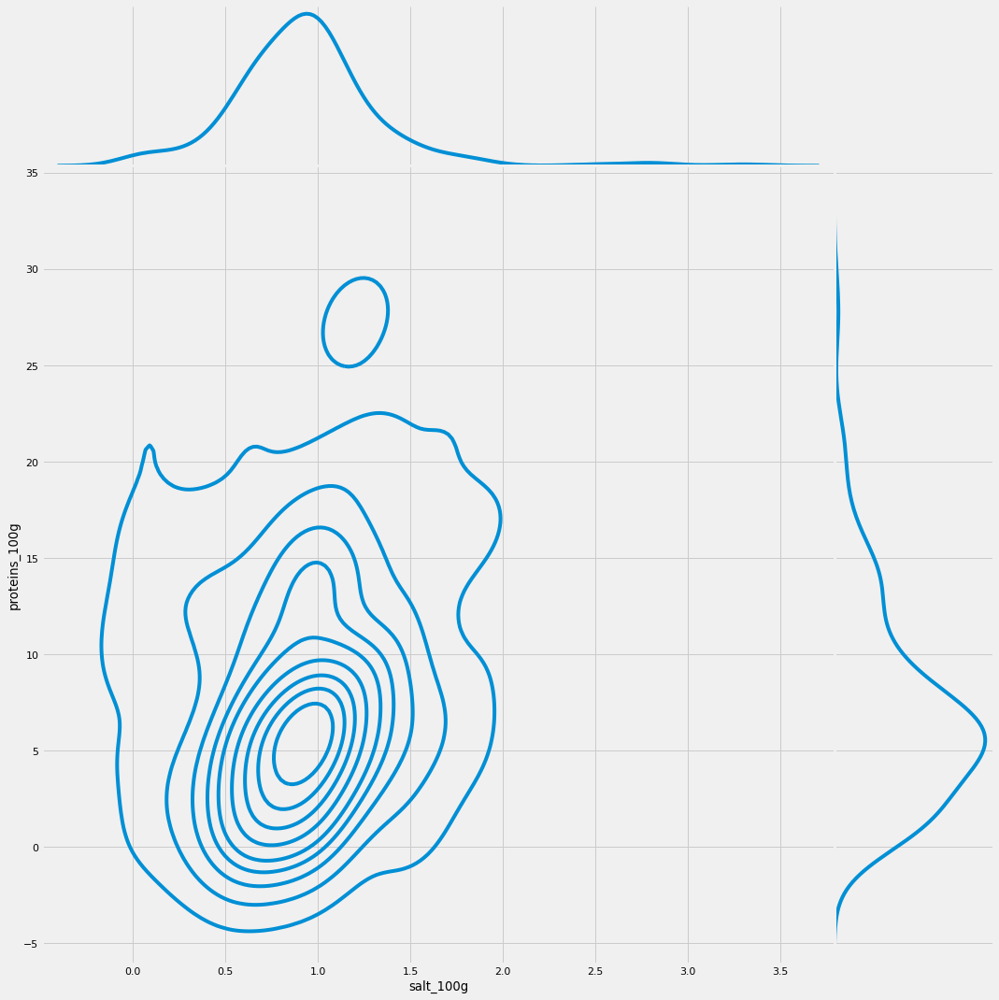

In [76]:
g = sns.jointplot(products['salt_100g'], products['proteins_100g'], kind="kde", height=15, space=0)

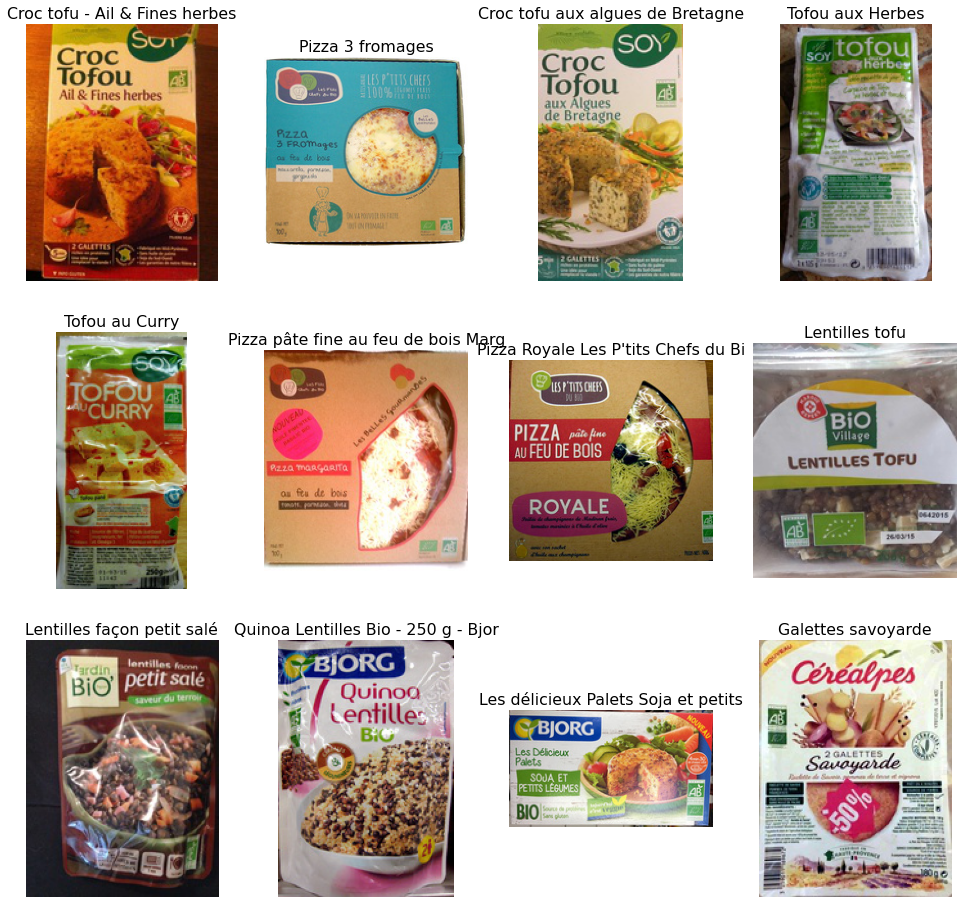

,code,product_name,categories_fr,nutrition_grade_fr,additives_fr,energy_100g,sugars_100g,fat_100g,salt_100g,fruits-vegetables-nuts_100g
213801,3259010301103,Croc tofu - Ail & Fines herbes,"Aliments et boissons à base de végétaux,Aliments d'origine végétale,Plats pr...",a,"E516 - Sulfate de calcium,E511 - Chlorure de magnésium,E412 - Gomme de guar",731.0,1.0,9.2,1.00000,38.494011
254743,3760209680041,Pizza 3 fromages,"Plats préparés,Pizzas tartes salées et quiches,Pizzas",c,NaN,1218.0,1.0,7.5,0.30000,38.494011
213806,3259010301608,Croc tofu aux algues de Bretagne,"Aliments et boissons à base de végétaux,Aliments d'origine végétale,Plats pr...",a,"E516 - Sulfate de calcium,E511 - Chlorure de magnésium",619.0,0.5,8.2,0.95000,12.100000
213791,3259010101512,Tofou aux Herbes,"Aliments et boissons à base de végétaux,Aliments d'origine végétale,Légumine...",a,E511 - Chlorure de magnésium,558.0,0.8,7.9,0.64000,38.494011
213829,3259011047765,Tofou au Curry,Plats préparés,a,"E511 - Chlorure de magnésium,E160c - Extrait de paprika",588.0,0.7,8.6,0.72898,38.494011
254741,3760209680027,Pizza pâte fine au feu de bois Margarita,"Plats préparés,Pizzas tartes salées et quiches,Pizzas",b,NaN,1266.0,1.0,5.0,0.50000,38.494011
254740,3760209680010,Pizza Royale Les P'tits Chefs du Bio,"Plats préparés,Pizzas tartes salées et quiches,Pizzas",b,E509 - Chlorure de calcium,1054.0,1.0,8.0,0.30000,38.494011
243297,3564707082082,Lentilles tofu,"Aliments et boissons à base de végétaux,Aliments d'origine végétale,Légumine...",a,"E511 - Chlorure de magnésium,E412 - Gomme de guar,E415 - Gomme xanthane",591.0,0.5,7.2,0.77800,38.494011
251522,3760020508883,Lentilles façon petit salé,Plats préparés,a,E300 - Acide ascorbique,487.0,0.6,2.0,0.75000,38.494011
202433,3229820188744,Quinoa Lentilles Bio - 250 g - Bjorg,"Aliments et boissons à base de végétaux,Aliments d'origine végétale,Céréales...",a,NaN,675.0,0.1,2.8,1.01600,38.494011


In [77]:
#Fat < 10g et sel < 1.25g et 1g de sucre
p = products[(products.image_small_url.notnull())&(products.salt_100g<1.25)&(products.fat_100g<10)&(products.sugars_100g<=1)]
top = p.nlargest(12,'proteins_100g')
display_products(top,rows=3,columns=4)

## ACP : Recherche des composantes principales
Recherche de correlations
- sel & sodium (comme vu plus haut)
- sucrose, glucose, carbohydrates
- fat, energy from fat, energy

Le premier plan factoriel concentre 25% de l'information

In [78]:
def pca_circles(pcs, n_comp, pca, axis_ranks, labels=None, label_rotation=0, lims=None):
    for d1, d2 in axis_ranks: # On affiche les 3 premiers plans factoriels, donc les 6 premières composantes
        if d2 < n_comp:

            # initialisation de la figure
            fig, ax = plt.subplots(figsize=(15,15))

            # détermination des limites du graphique
            if lims is not None :
                xmin, xmax, ymin, ymax = lims
            elif pcs.shape[1] < 30 :
                xmin, xmax, ymin, ymax = -1, 1, -1, 1
            else :
                xmin, xmax, ymin, ymax = min(pcs[d1,:]), max(pcs[d1,:]), min(pcs[d2,:]), max(pcs[d2,:])

            # affichage des lignes horizontales et verticales
            plt.plot([-1, 1], [0, 0], color='#333333',lw=1, ls='-',zorder=1)
            plt.plot([0, 0], [-1, 1], color='#333333',lw=1, ls='-',zorder=1)
            # affichage des flèches
            # s'il y a plus de 30 flèches, on n'affiche pas le triangle à leur extrémité
            lines = [[[0,0],[x,y]] for x,y in pcs[[d1,d2]].T]
            ax.add_collection(LineCollection(lines, axes=ax, alpha=.7,linewidths=(1), color='red'))
            
            # affichage des noms des variables  
            if labels is not None:  
                for i,(x, y) in enumerate(pcs[[d1,d2]].T):
                    if x >= xmin and x <= xmax and y >= ymin and y <= ymax :
                        plt.text(x, y, labels[i], fontsize='8', ha='center', va='center', rotation=label_rotation, color="blue", alpha=0.5)
            
            # affichage du cercle
            circle = plt.Circle((0,0), 1, facecolor='none', edgecolor='b')
            plt.gca().add_artist(circle)

            # définition des limites du graphique
            plt.xlim(xmin, xmax)
            plt.ylim(ymin, ymax)
        
            

            # nom des axes, avec le pourcentage d'inertie expliqué
            plt.xlabel('F{} ({}%)'.format(d1+1, round(100*pca.explained_variance_ratio_[d1],1)))
            plt.ylabel('F{} ({}%)'.format(d2+1, round(100*pca.explained_variance_ratio_[d2],1)))

            plt.title("Cercle des corrélations (F{} et F{})".format(d1+1, d2+1))
            plt.show(block=False)

Perform our PCA on quantitaive variables (100g)

Remove duplicates variables 

In [79]:
"""nutriments = ['energy_100g',
              'carbohydrates_100g','sugars_100g',
              'saturated-fat_100g','fat_100g','trans-fat_100g',
              'sodium_100g','alcohol_100g',
              'fiber_100g','proteins_100g',
              'fruits-vegetables-nuts_100g',
             'nutrition-score-fr_100g','calcium_100g','iron_100g']
"""
nutriments = []
for c in df.columns:
    if "_100g" in c and '-uk' not in c:
        nutriments.append(c)

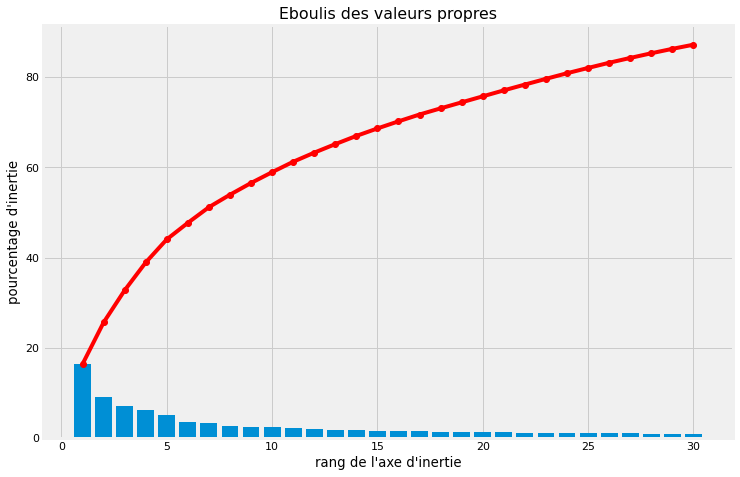

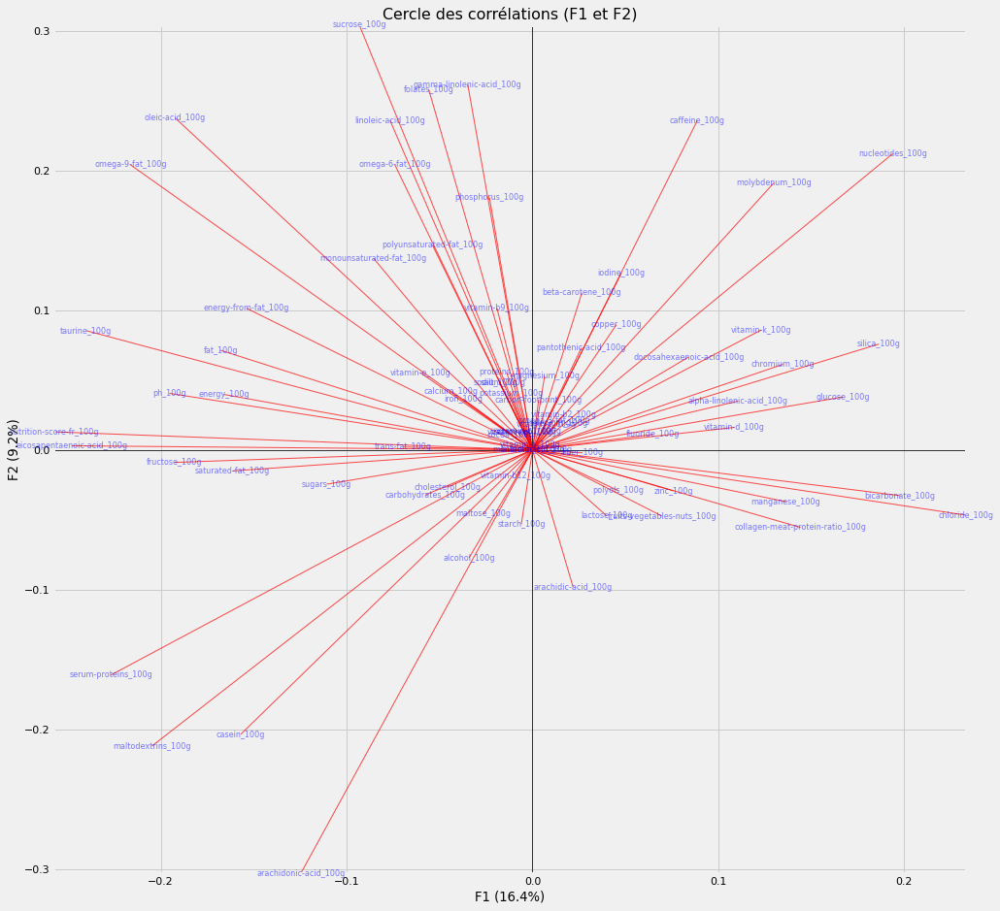

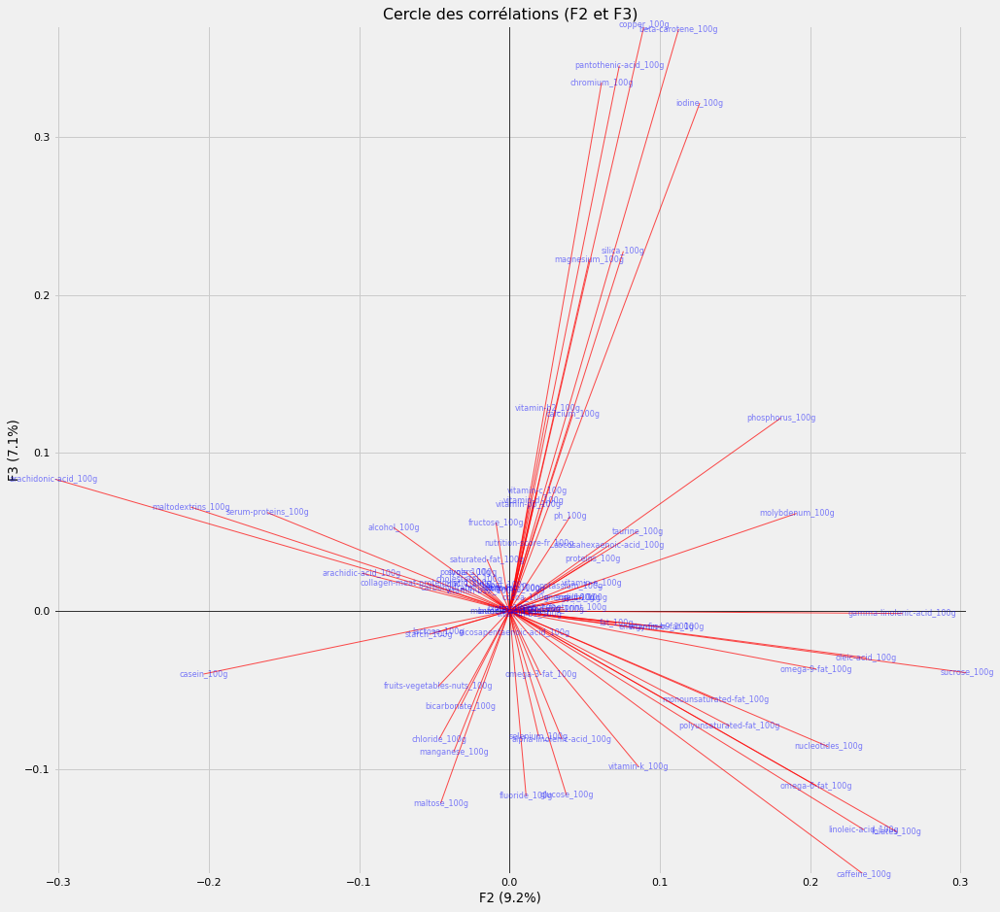

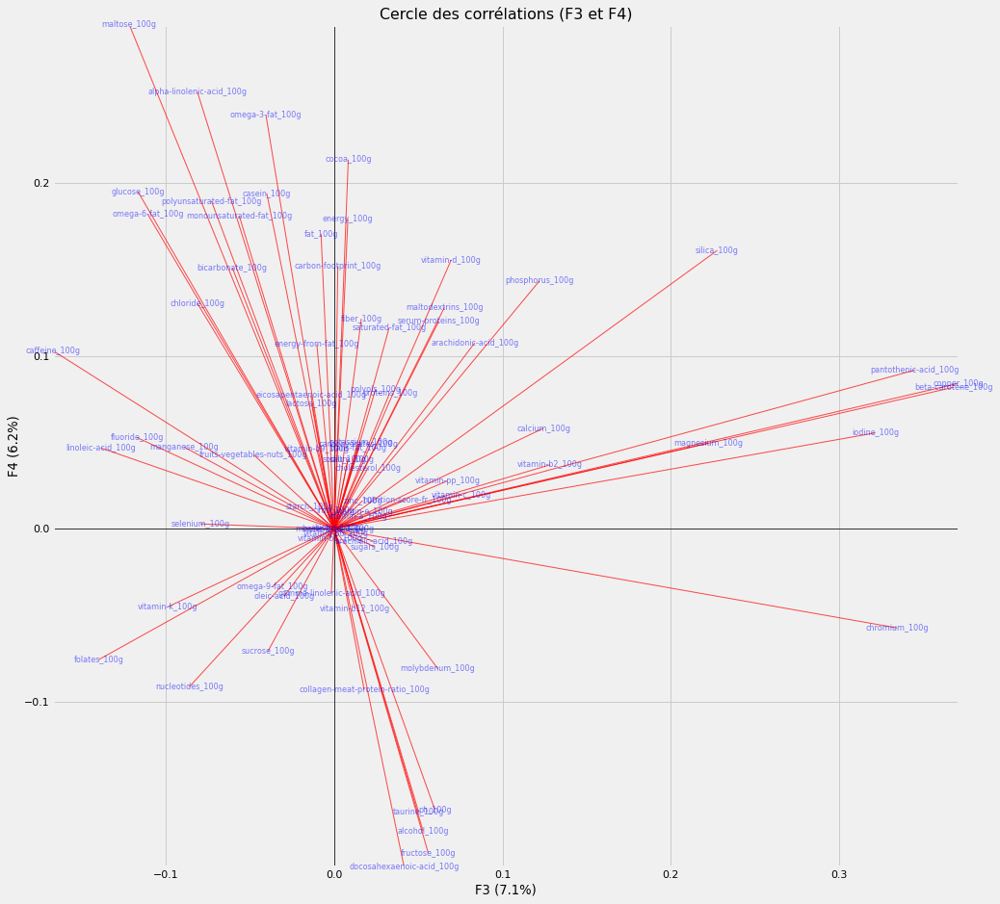

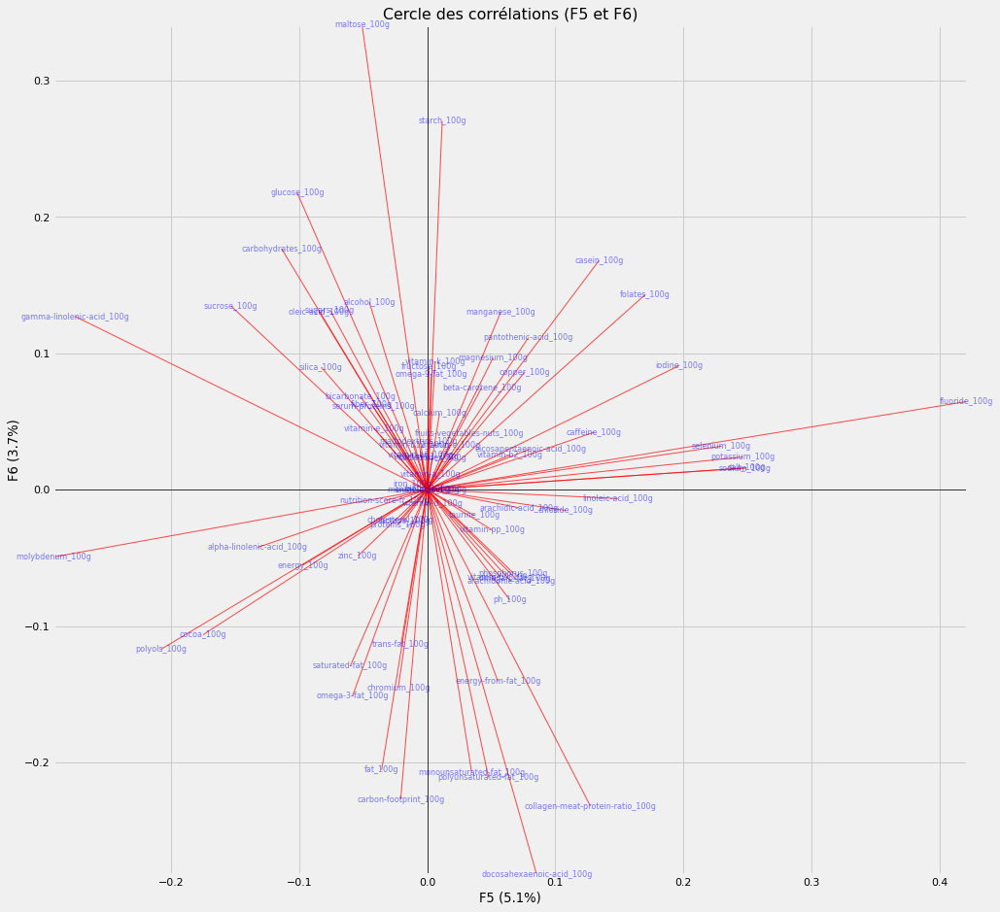

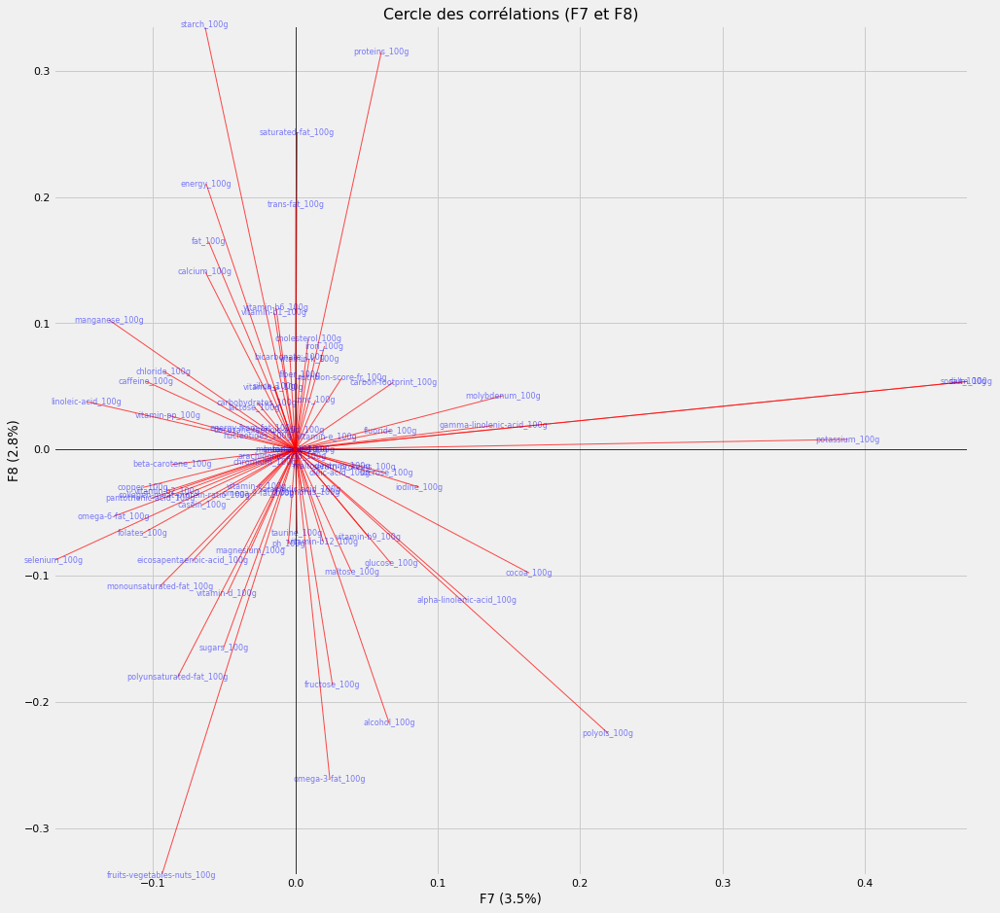

In [80]:
from sklearn import decomposition
from sklearn import preprocessing

fig, ax = setup_figure()
# choix du nombre de composantes à calculer
n_comp = 30

# selection des colonnes à prendre en compte dans l'ACP
data_pca = df[nutriments]

# préparation des données pour l'ACP
data_pca = data_pca.fillna(data_pca.mean()) # Il est fréquent de remplacer les valeurs inconnues par la moyenne de la variable
X = data_pca.values
names = df["nutrition_grade_fr"] # ou data.index pour avoir les intitulés
features = nutriments

# Centrage et Réduction
std_scale = preprocessing.StandardScaler().fit(X)
X_scaled = std_scale.transform(X)

# Calcul des composantes principales
pca = decomposition.PCA(n_components=n_comp)
pca.fit(X_scaled)

# Eboulis des valeurs propres
display_scree_plot(pca)

# Cercle des corrélations
pcs = pca.components_
scree = pca.explained_variance_ratio_*100

pca_circles(pcs, n_comp, pca, [(0,1),(1,2),(2,3),(4,5),(6,7)], labels = np.array(features))



plt.show()

## Test de significativité et correlation sur 3 composantes

In [82]:
components1=['fructose_100g','sugars_100g','sodium_100g']
components2=['fruits-vegetables-nuts_100g','polyunsaturated-fat_100g','alcohol_100g']
#sample = df.iloc[]


for (c1,c2) in list(zip(components1,components2)):
    print(c1,c2)
    #Test de normalité
    k2, p = stats.normaltest(sample[c1].tolist())
    print("Normalité distribution ",c1,": ",p)

    k2, p = stats.normaltest(sample[c2].tolist())
    print("Normalité distribution ",c2,": ",p)


    #Test de significativité : p_value inférieure à 0.1%
    cor, p_value = stats.pearsonr(sample[c1].tolist(), sample[c2].tolist())
    print('Coefficient de correlation (',c1,',',c2,'):',cor,' p_value=',p_value)

fructose_100g fruits-vegetables-nuts_100g
Normalité distribution  fructose_100g :  0.0
Normalité distribution  fruits-vegetables-nuts_100g :  0.0
Coefficient de correlation ( fructose_100g , fruits-vegetables-nuts_100g ): -0.07861211363113181  p_value= 2.135164472152307e-111
sugars_100g polyunsaturated-fat_100g
Normalité distribution  sugars_100g :  0.0
Normalité distribution  polyunsaturated-fat_100g :  0.0
Coefficient de correlation ( sugars_100g , polyunsaturated-fat_100g ): -0.00915052818947949  p_value= 0.009145517111112061
sodium_100g alcohol_100g
Normalité distribution  sodium_100g :  0.0
Normalité distribution  alcohol_100g :  0.0
Coefficient de correlation ( sodium_100g , alcohol_100g ): -0.0267036068942586  p_value= 2.7873390549827302e-14
